# Setup

## Define Input & Free Parameters

In [1]:
fname = 'max_diadem.png'
max_power_2_sigma = 5
max_radius = 6
membrane_kernel_size = 19
max_shift = 3
persistence_coarse = 8.5
persistence_fine = 0.5

## Imports

In [2]:
import matplotlib.pyplot as plt
from skimage import io, filters, morphology, restoration, feature, transform
from sklearn import ensemble, svm, model_selection, neighbors, linear_model, gaussian_process, neural_network 
import numpy as np
from read_msc import *
from scipy import ndimage, stats
from ipywidgets import widgets, interact
import subprocess
import os
import sys
from collections import namedtuple
import time

import scipy
# Needed for kdTree on large point sets:
import sys
sys.setrecursionlimit(10000)

## Pretty Colors

In [3]:
light_red = '#fbb4ae'
red = '#e41a1c'

light_blue = '#b3cde3'
blue = '#377eb8'

light_green = '#ccebc5'
green = '#4daf4a'

light_purple = '#decbe4'
purple = '#984ea3'

light_orange = '#fed9a6'
orange = '#ff7f00'

light_palette = [light_red, light_blue, light_green, light_purple, light_orange]
bold_palette = [red, blue, green, purple, orange]

## Reusable Variables and Functions

In [4]:
def show_image(image):
    plt.figure(num=None, dpi=200)
    plt.imshow(image, cmap=plt.cm.Greys_r)

def show_training_samples(image, in_samples, out_samples):
    show_image(image)
    plt.scatter(in_samples[:, 0], in_samples[:, 1], color=orange, s=1, marker=',')
    plt.scatter(out_samples[:, 0], out_samples[:, 1], color=purple, s=1, marker=',')
    
classifiers = {}

# Feature Generation

## Load Test Image

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/io/_io.py:54: UserWarning: `flatten` has been deprecated in favor of `as_gray` and will be removed in v0.16.
  warn('`flatten` has been deprecated in favor of `as_gray`'


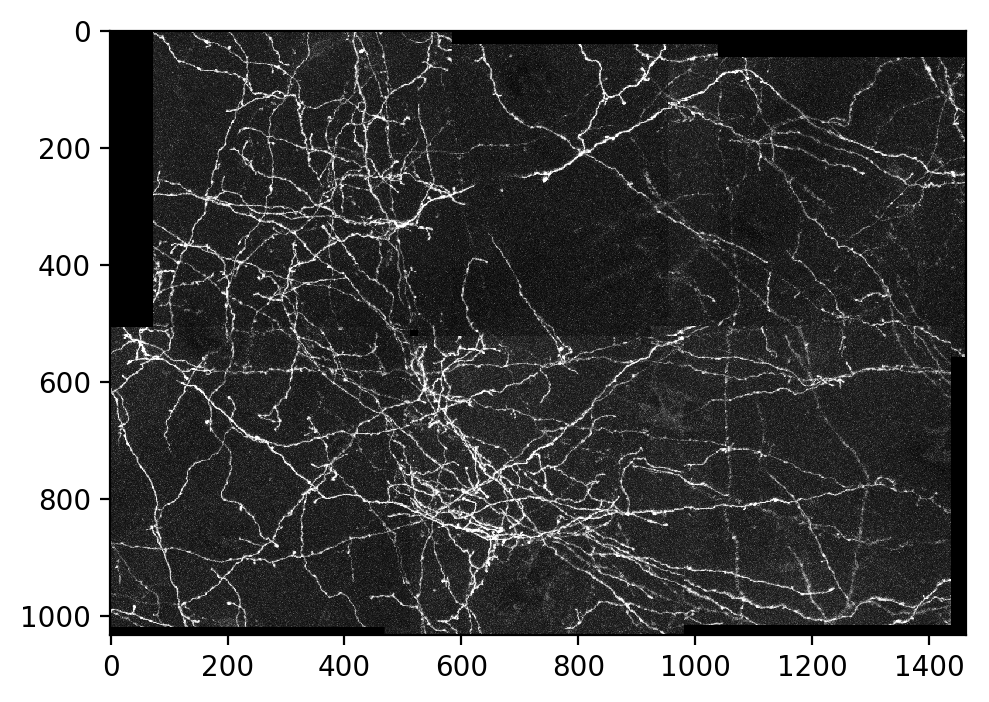

In [5]:
# Google is using an older version of skimage, we need to use "flatten" instead
# of "as_gray." I am leaving both for enhanced compatibility
image = io.imread(fname, as_gray=True, flatten=True)
show_image(image)

## Smooth the Test Image

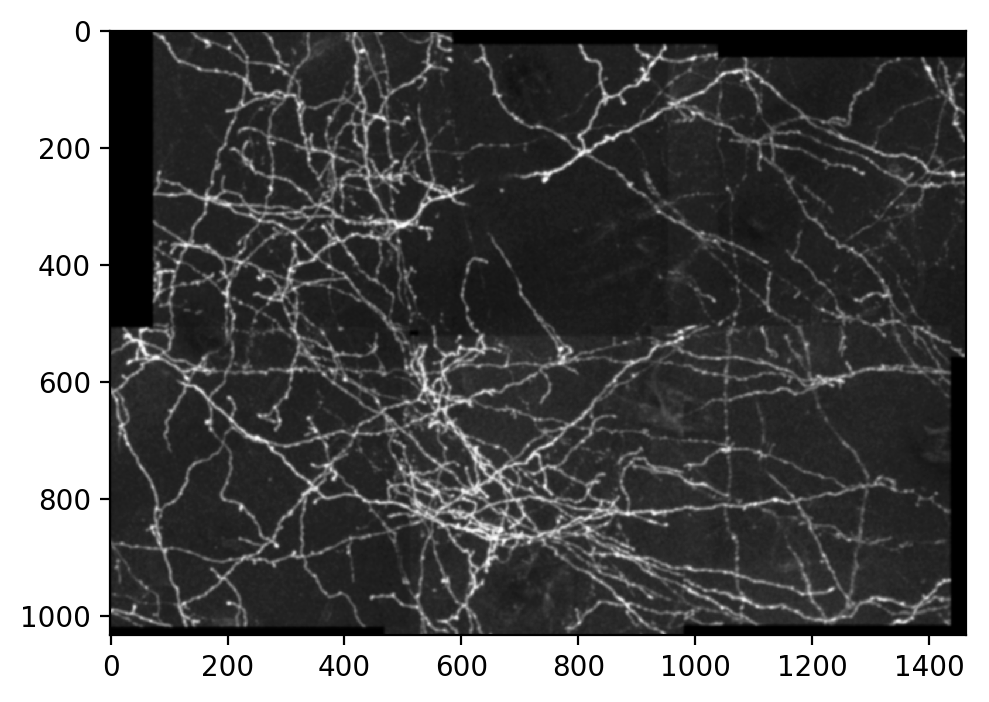

In [6]:
blurred_image = filters.gaussian(image, sigma=2**1)
plt.figure(num=None, dpi=200)
plt.imshow(blurred_image, cmap=plt.cm.Greys_r)
fname_raw = fname.rsplit('.', 1)[0] + '_smoothed.raw'
blurred_image.astype('float32').tofile(fname_raw)
image = blurred_image

## Look at Some Info about the Image

This will be useful later on to look to set the initial persistence threshold of the Morse-Smale Complex construction.

(1033, 1464)
0.0 0.9205598633046345


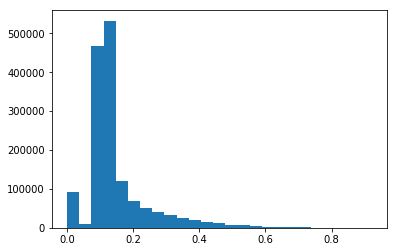

In [7]:
print(image.shape)
print(np.min(image.flatten()), np.max(image.flatten()))

# To generate input file for MSCVisus:
# image.astype('float32').tofile('lightning_smoothed.raw')

_ = plt.hist(image.flatten(), 25)

## Create Features by Creating/Applying Filters

### Gaussian Blur

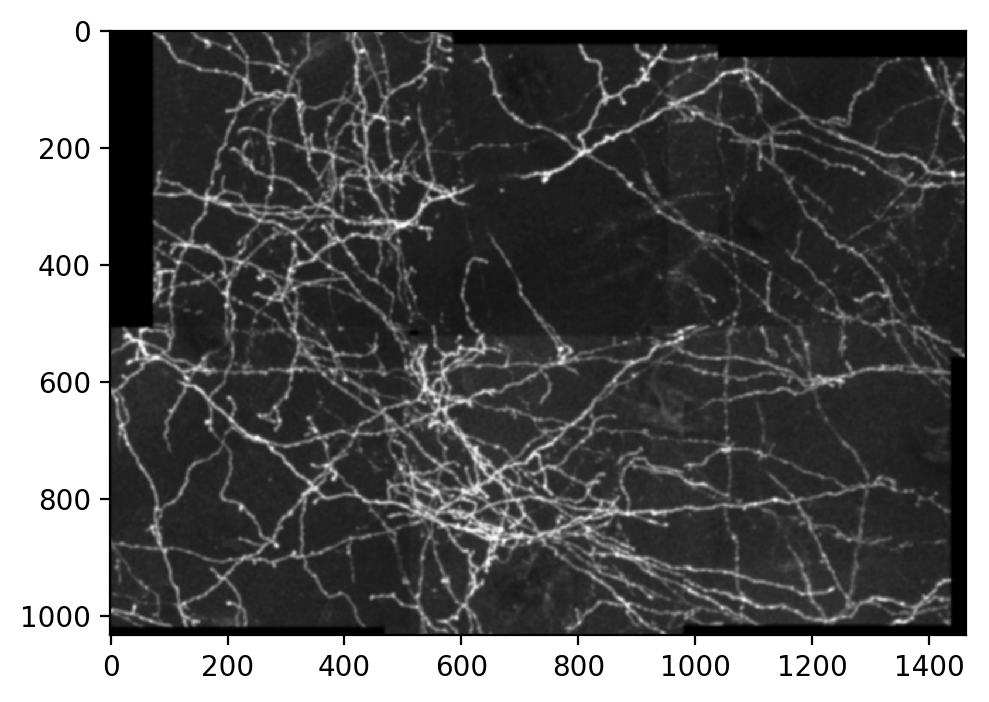

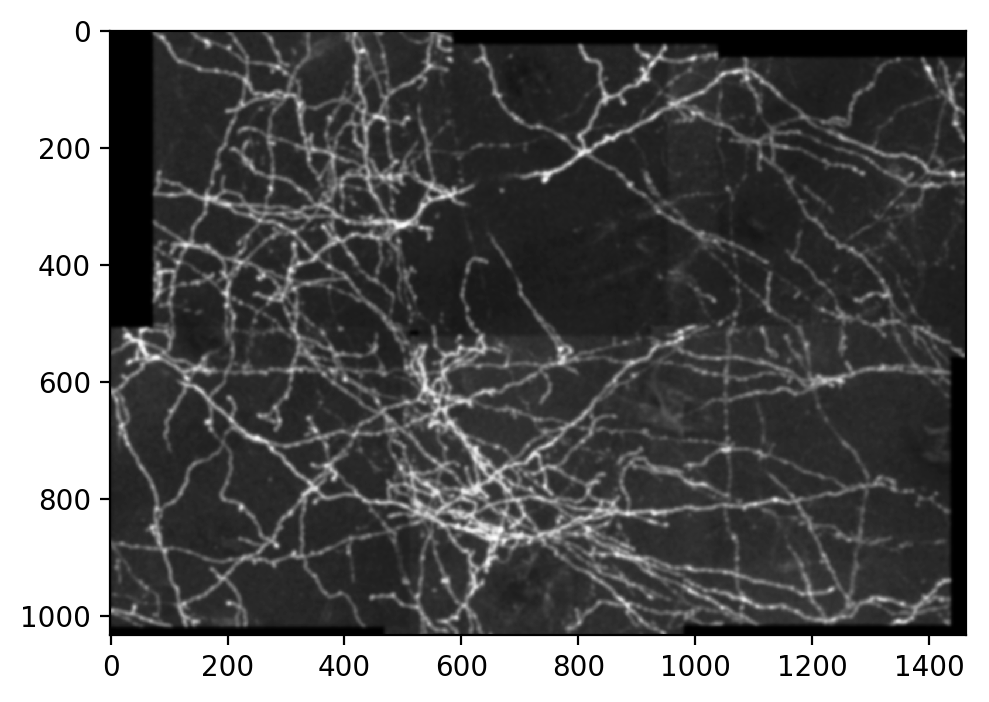

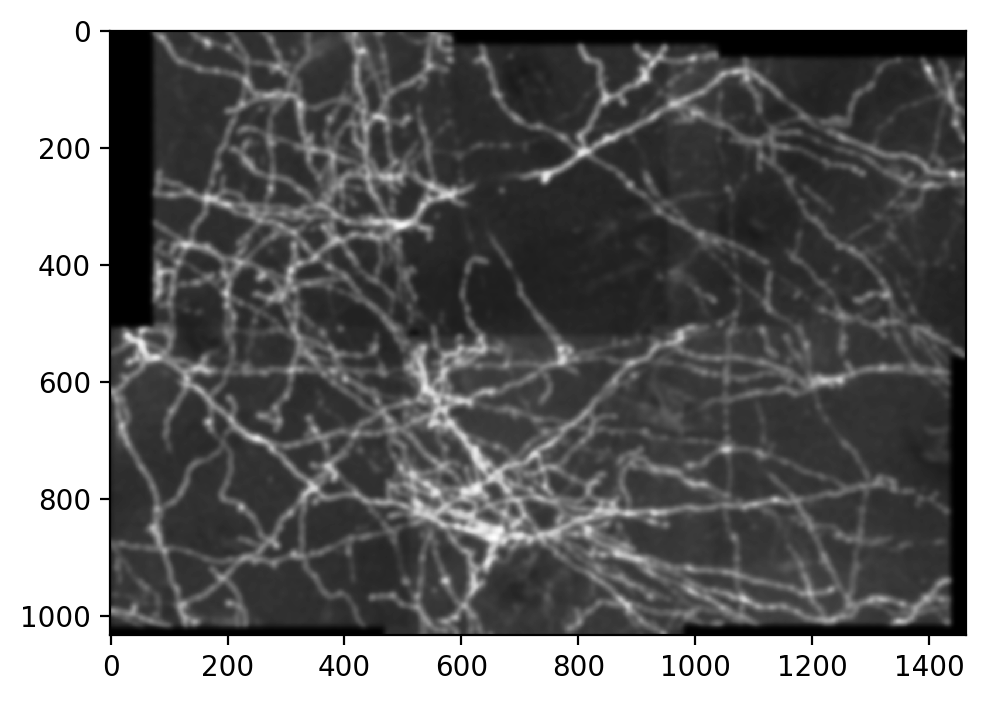

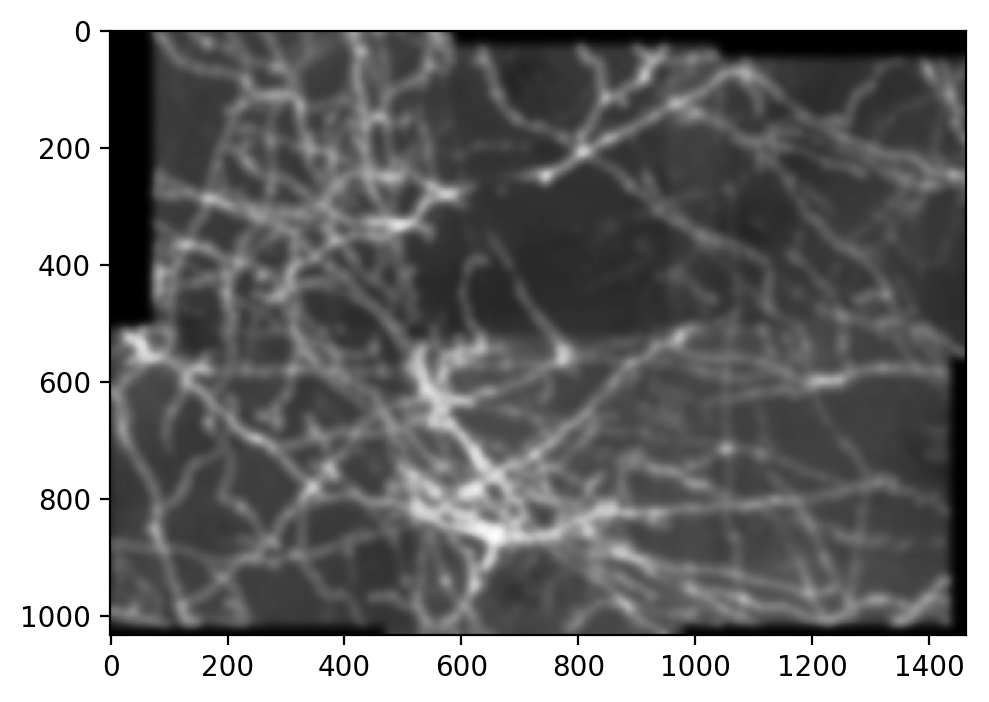

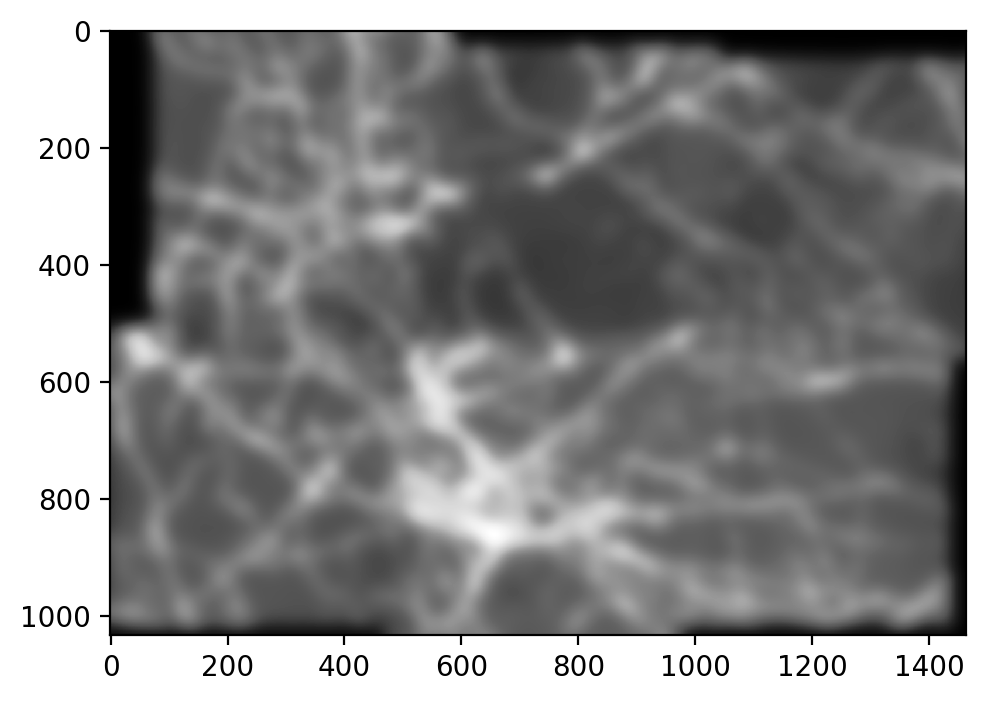

In [8]:
blur_images = []
for i in range(0, max_power_2_sigma):
    blur_images.append(filters.gaussian(image, sigma=2**i))
    
for blur_image in blur_images:
    show_image(blur_image)

### Difference of Gaussians

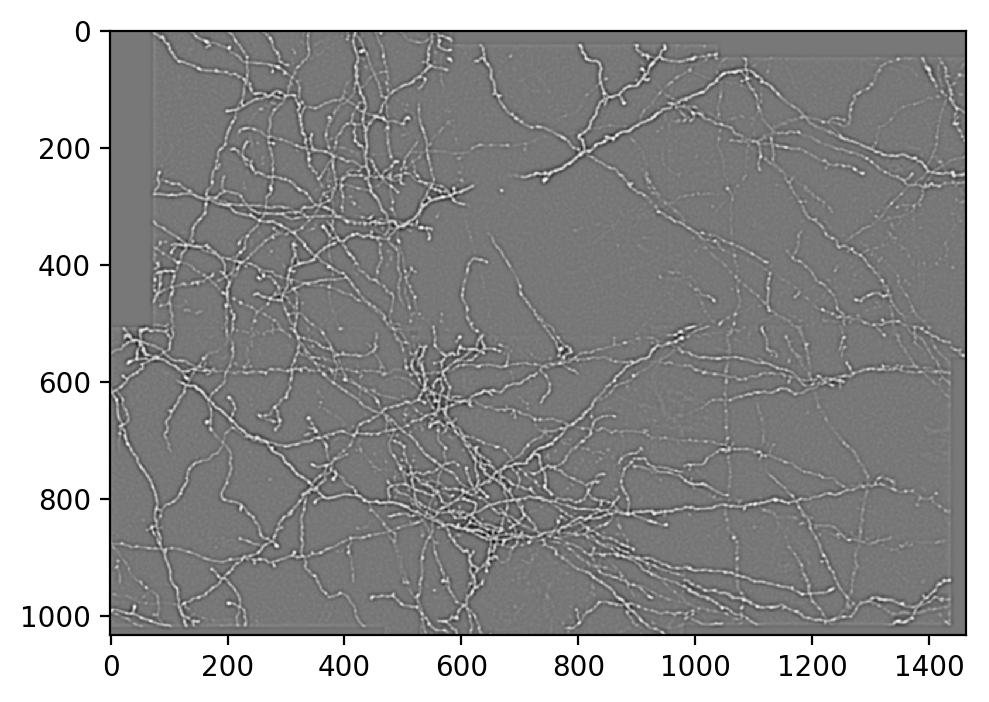

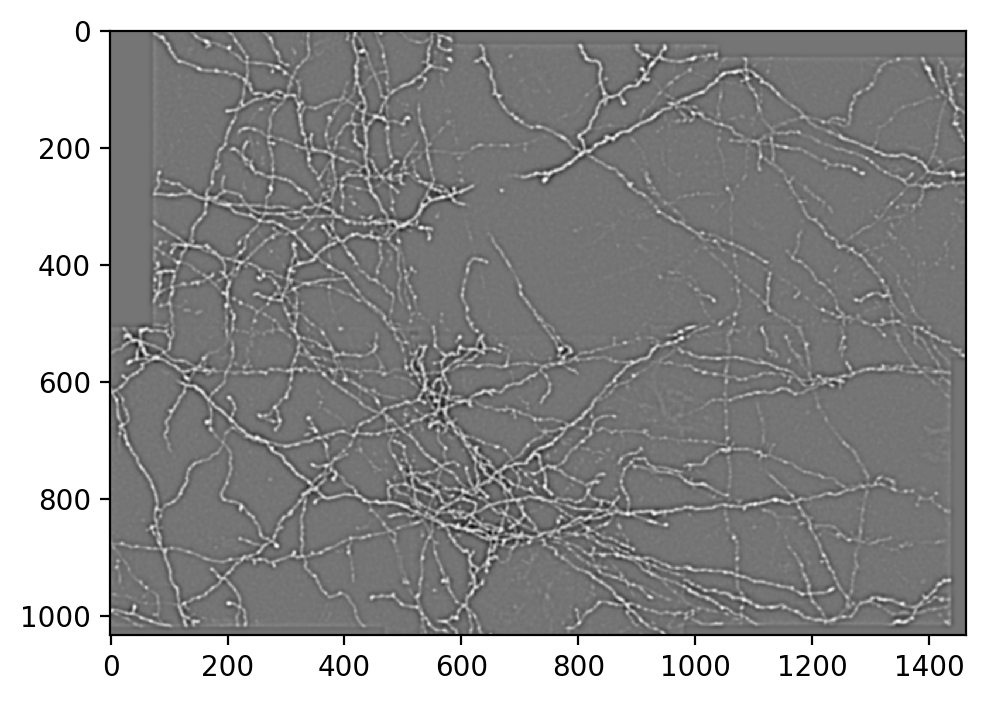

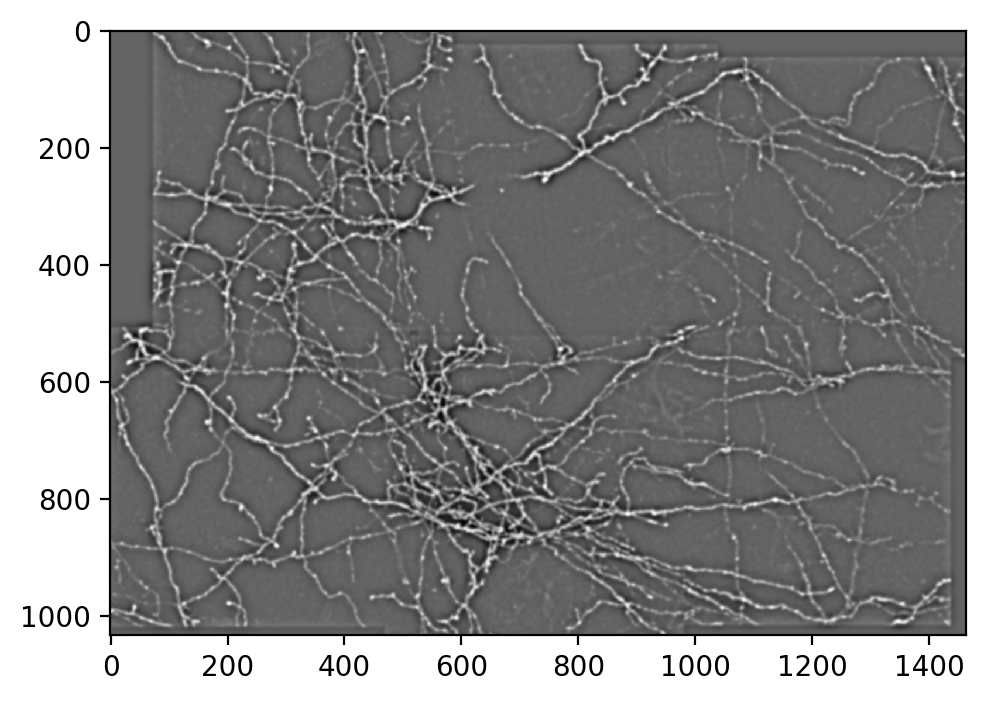

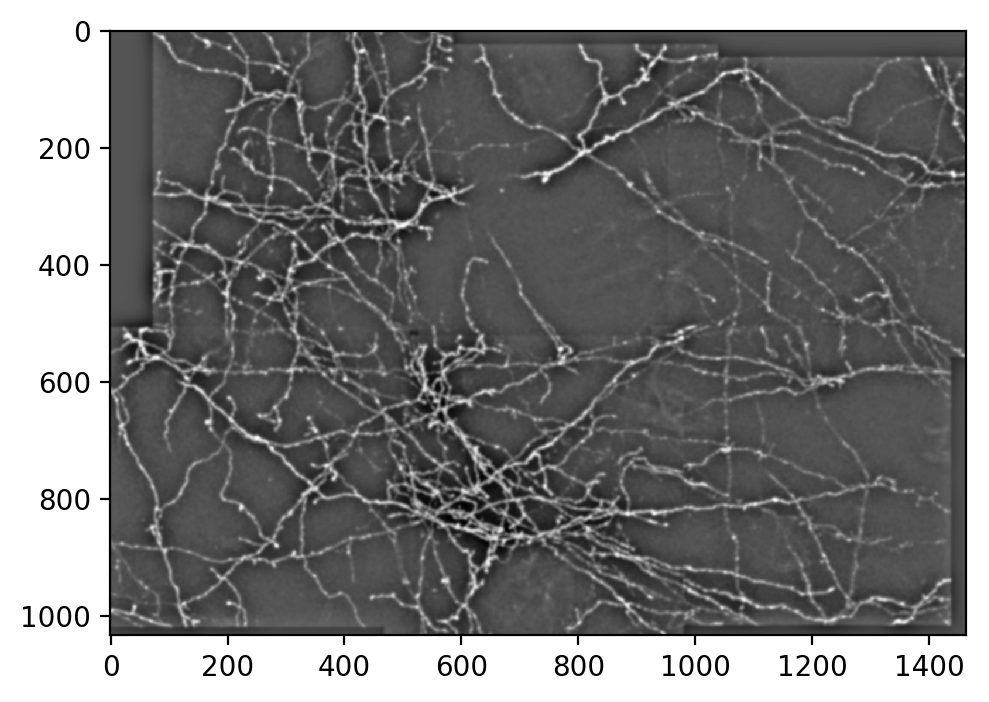

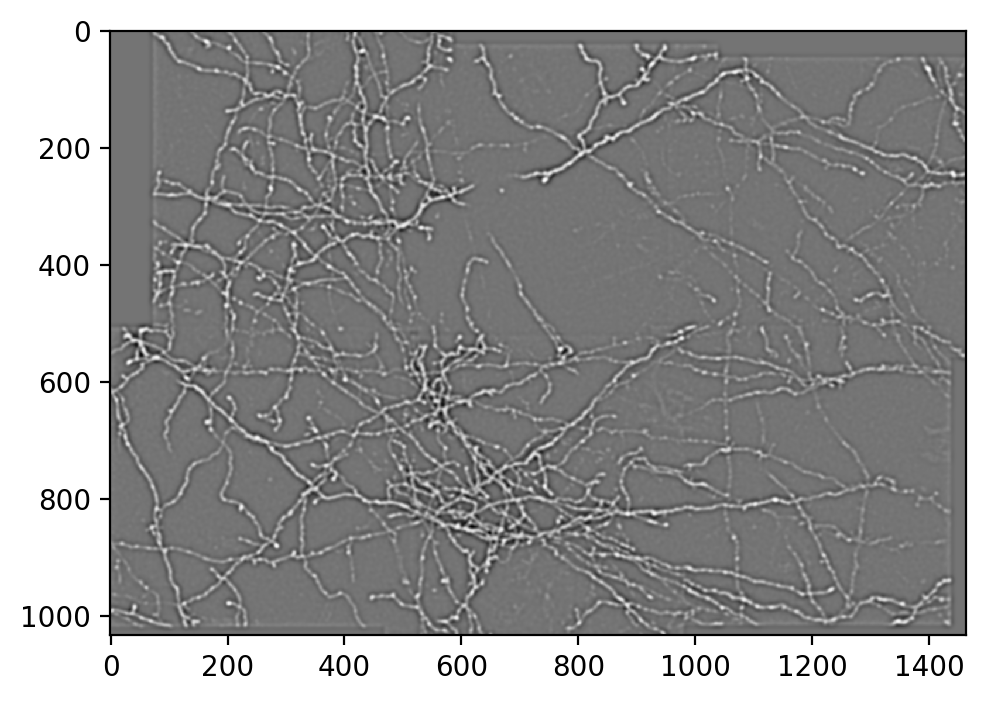

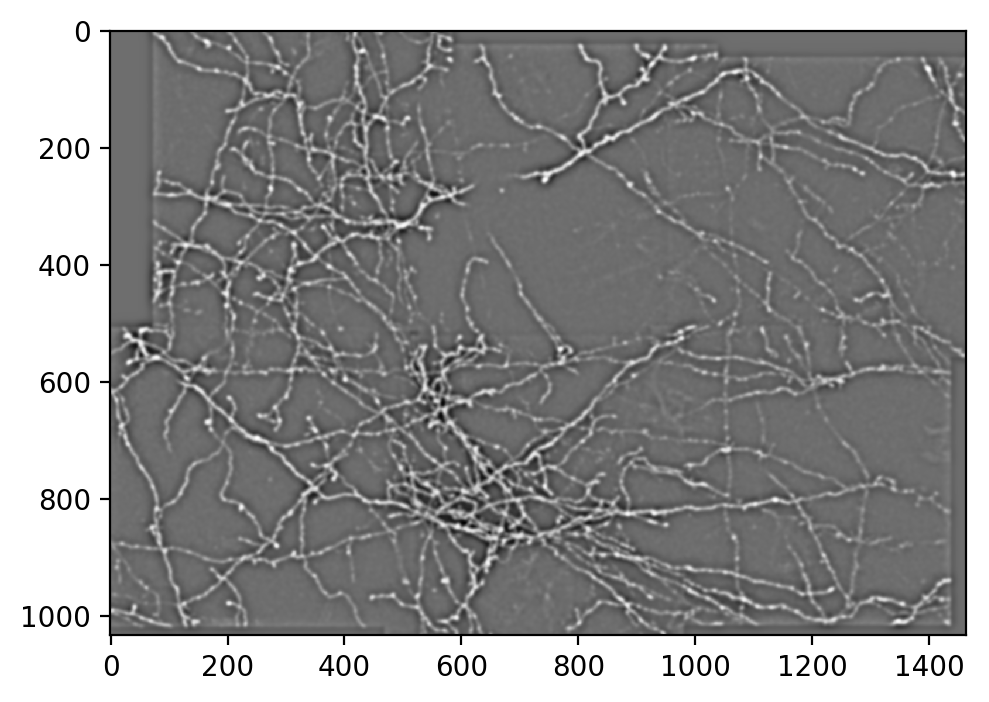

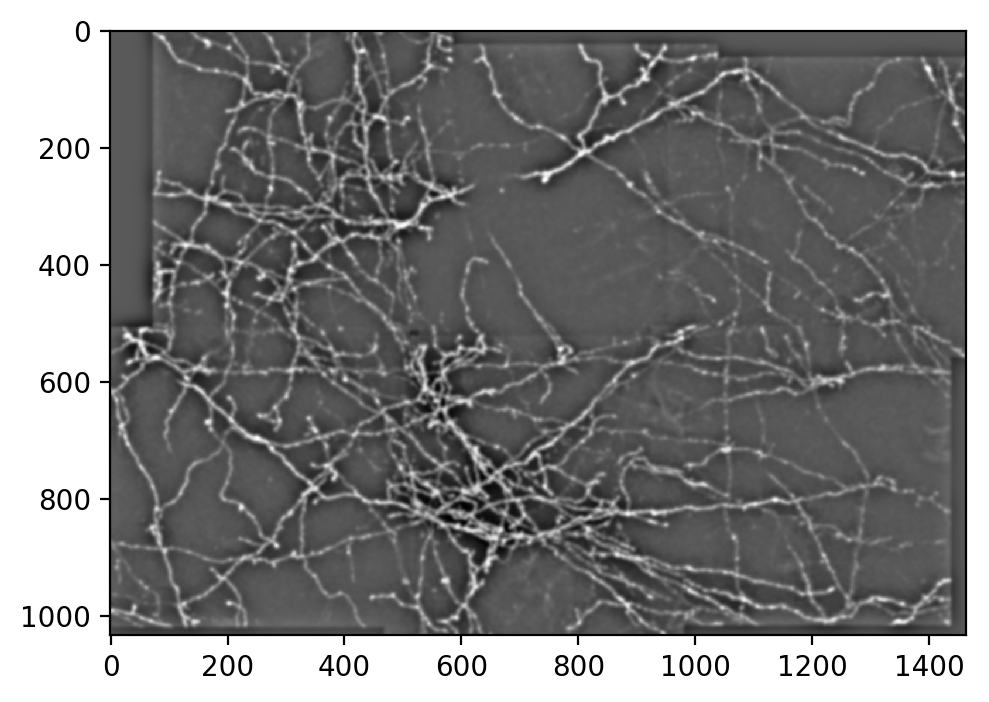

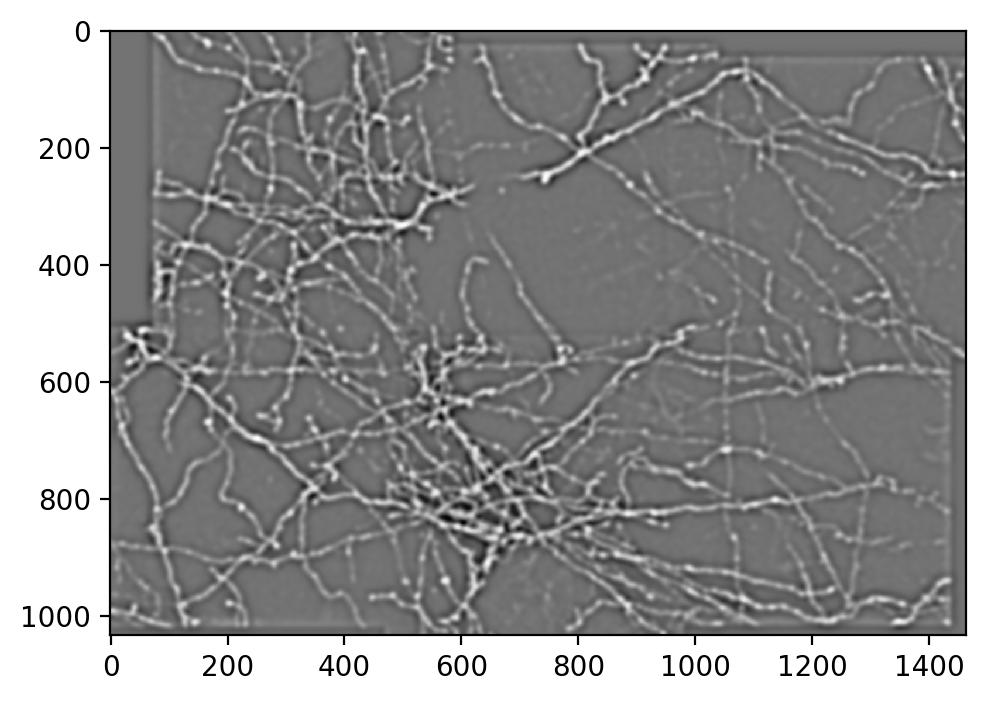

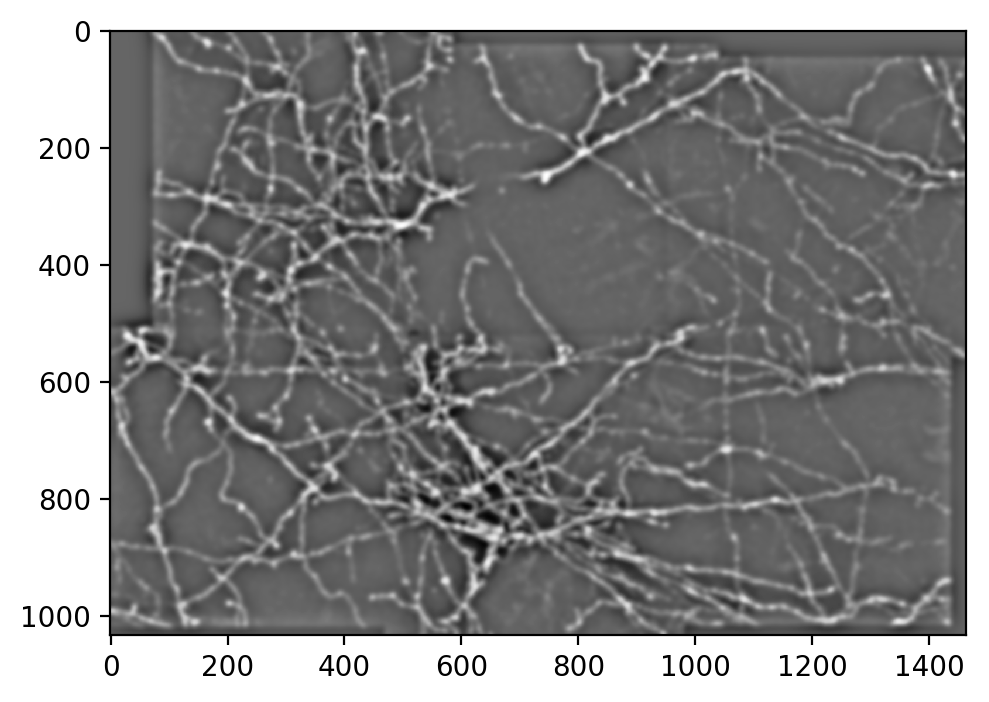

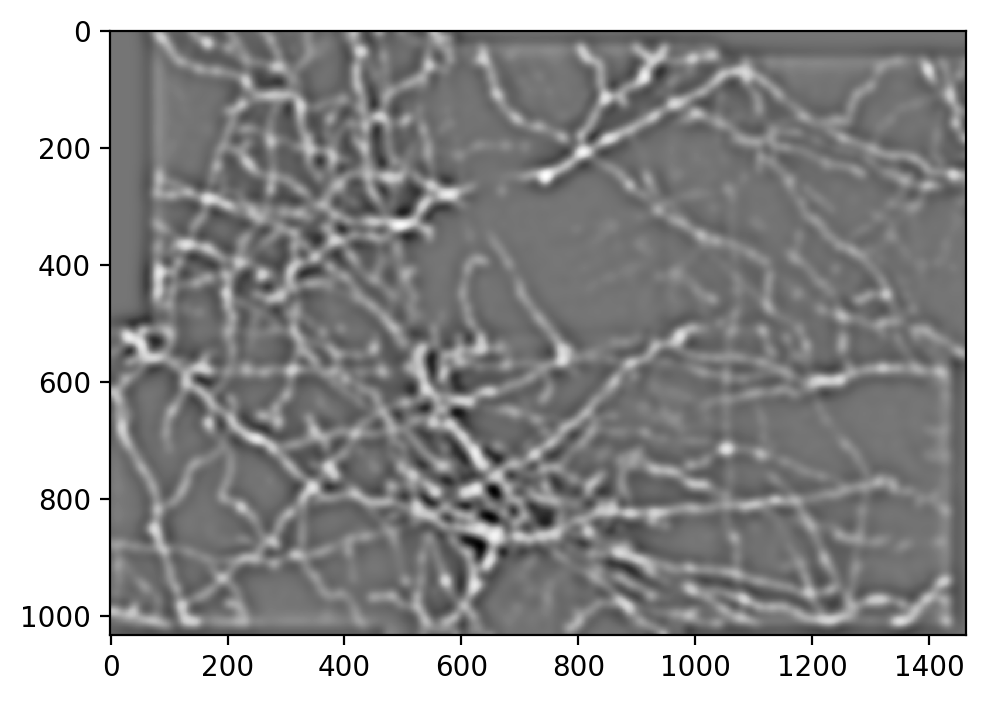

In [9]:
diff_images = []
for i, blur in enumerate(blur_images):
    for blur2 in blur_images[i+1:]:
        diff_images.append(blur-blur2)

for diff_image in diff_images:
    show_image(diff_image)

### Membrane Projections

In [10]:
membrane_kernel = np.zeros((membrane_kernel_size, membrane_kernel_size))
membrane_kernel[:, membrane_kernel_size//2] = 1.

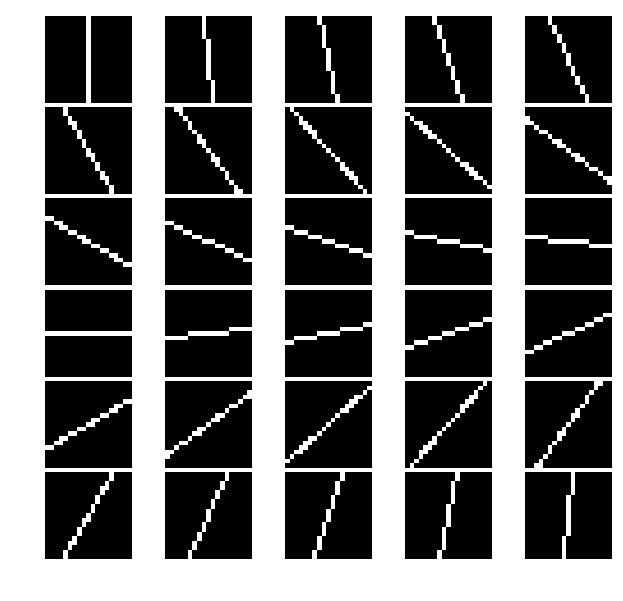

In [11]:
# Create the 30 test kernels from the base kernel and look at them to make sure that they make sense
test_kernels = []

fig, ax = plt.subplots(6, 5, figsize=(5, 6), dpi=120)
fig.subplots_adjust(left=0.0, right=1, hspace=0.05, wspace=0)
ax = ax.flatten()
for i, angle in enumerate(range(0, 180, 6)):
    test_kernels.append(transform.rotate(membrane_kernel, angle, resize=False, center=None, order=0, mode='edge', clip=True, preserve_range=True))
    ax[i].imshow(test_kernels[i], cmap=plt.cm.Greys_r)
    ax[i].axis('off')

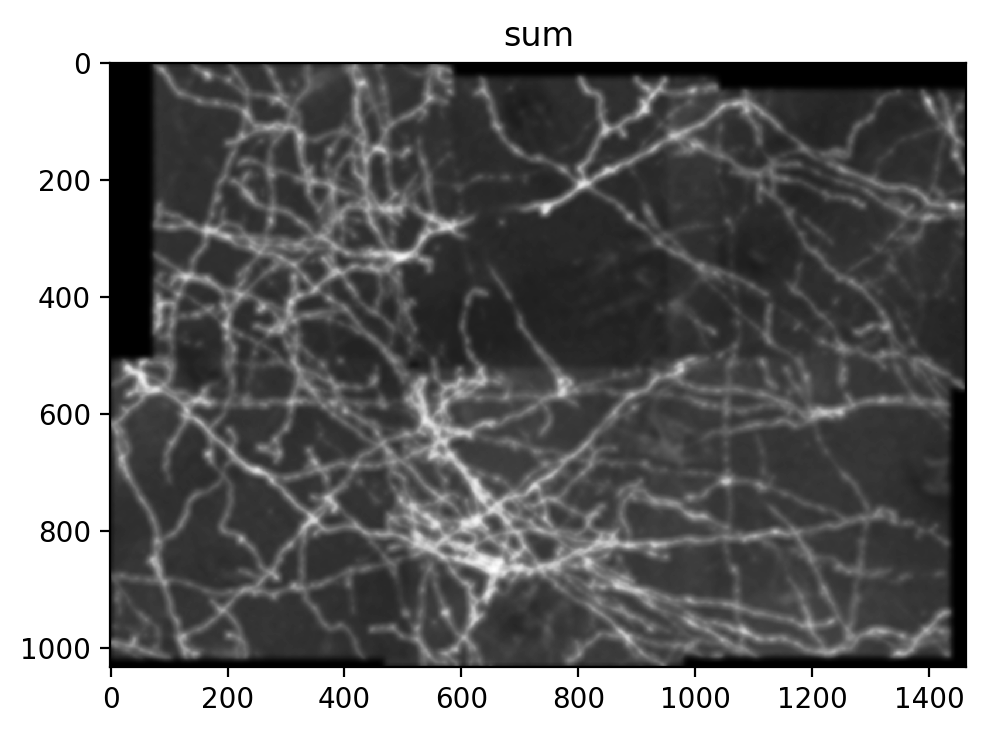

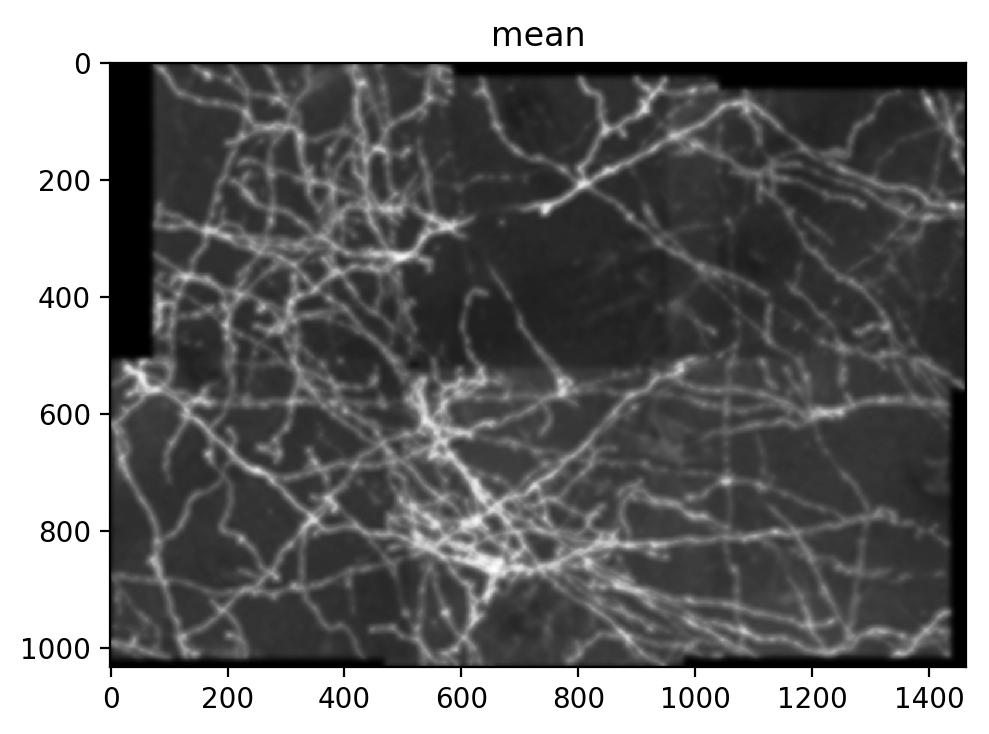

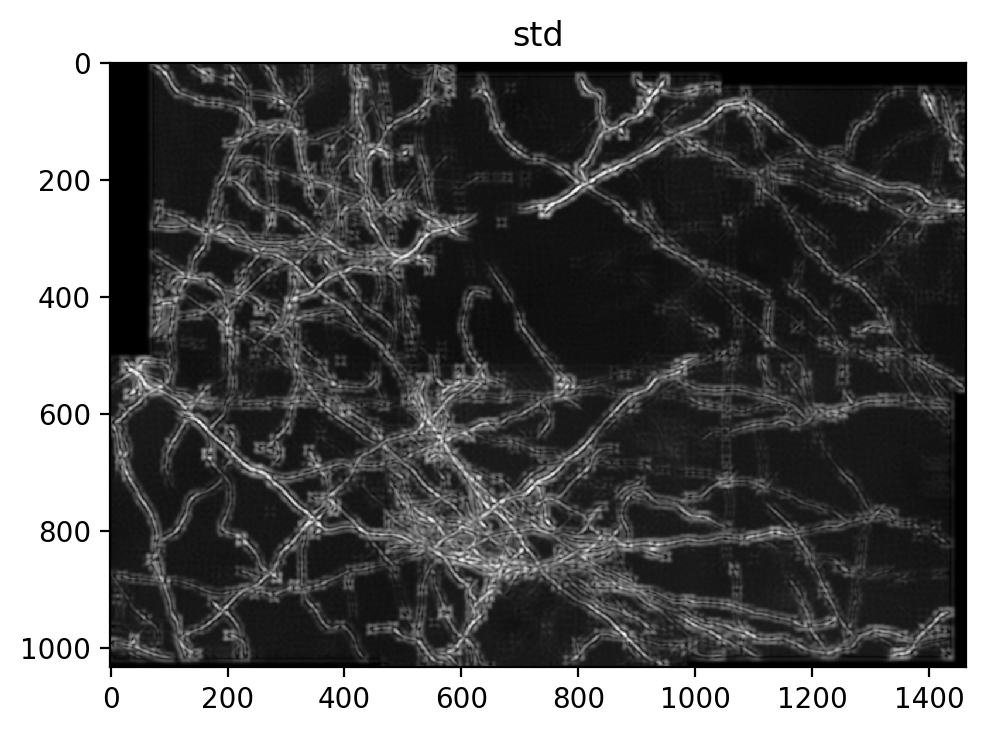

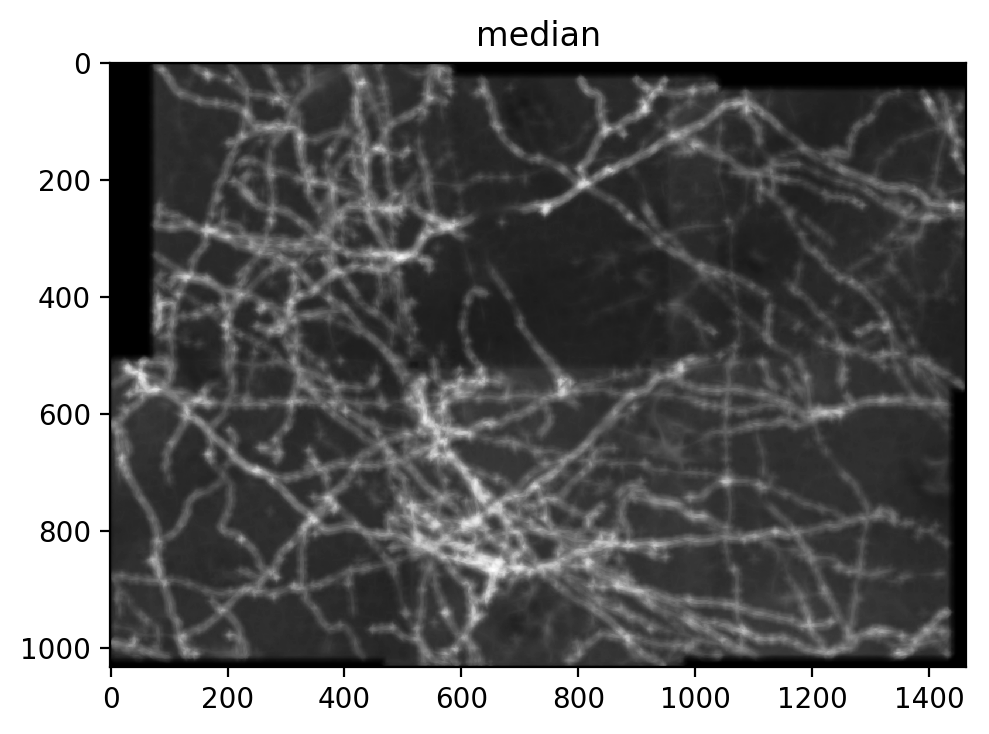

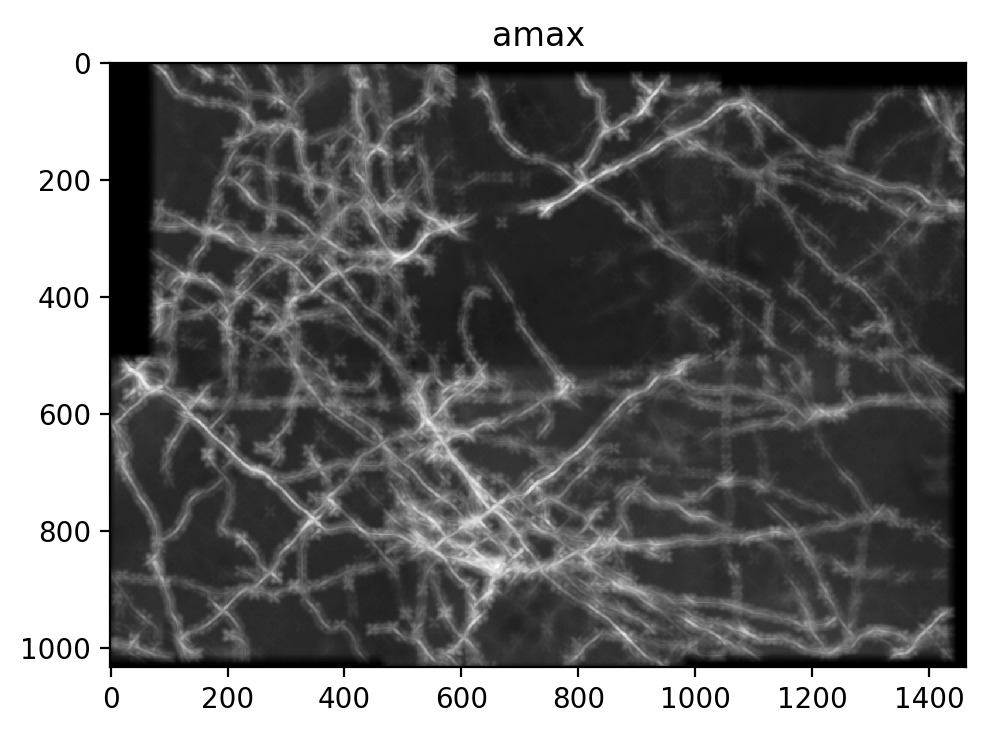

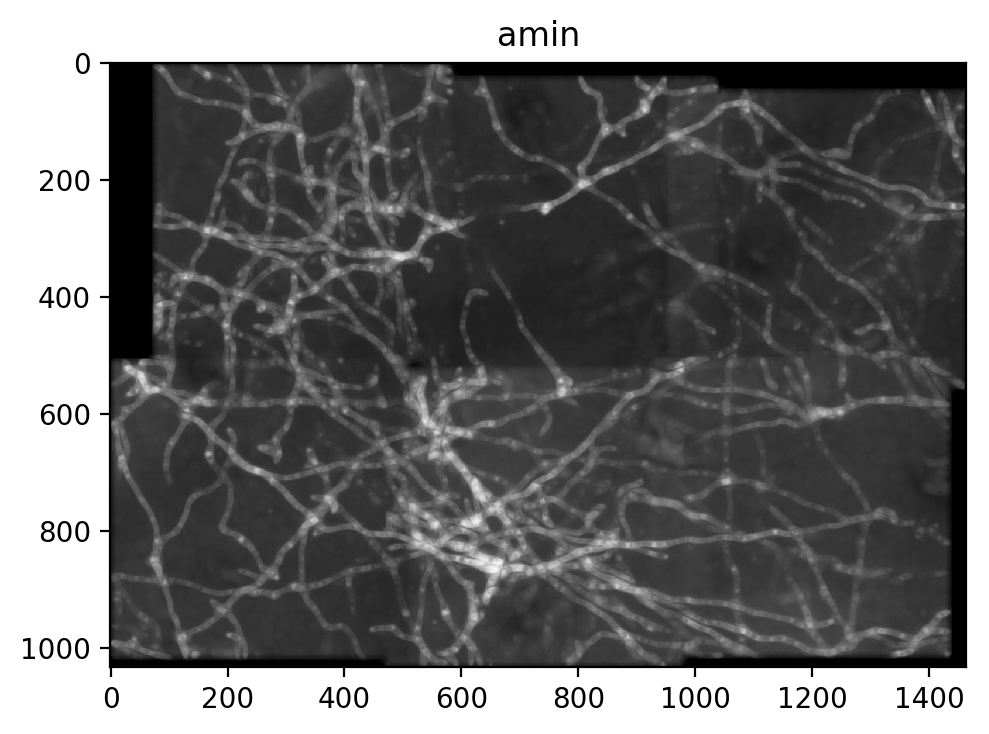

In [12]:
test_images = []
for test_kernel in test_kernels:
    test_images.append(ndimage.filters.convolve(image, test_kernel, mode='constant', cval=0))

stacked_images = np.dstack(tuple(test_images))
membrane_projection_images = []
names = []
for foo in [np.sum, np.mean, np.std, np.median, np.max, np.min]:
    membrane_projection_images.append(foo(stacked_images, axis=2))
    names.append(foo.__name__)

for title, membrane_projection_image in zip(names, membrane_projection_images):
    show_image(membrane_projection_image)
    plt.gca().set_title(title)

### Sobel Filter

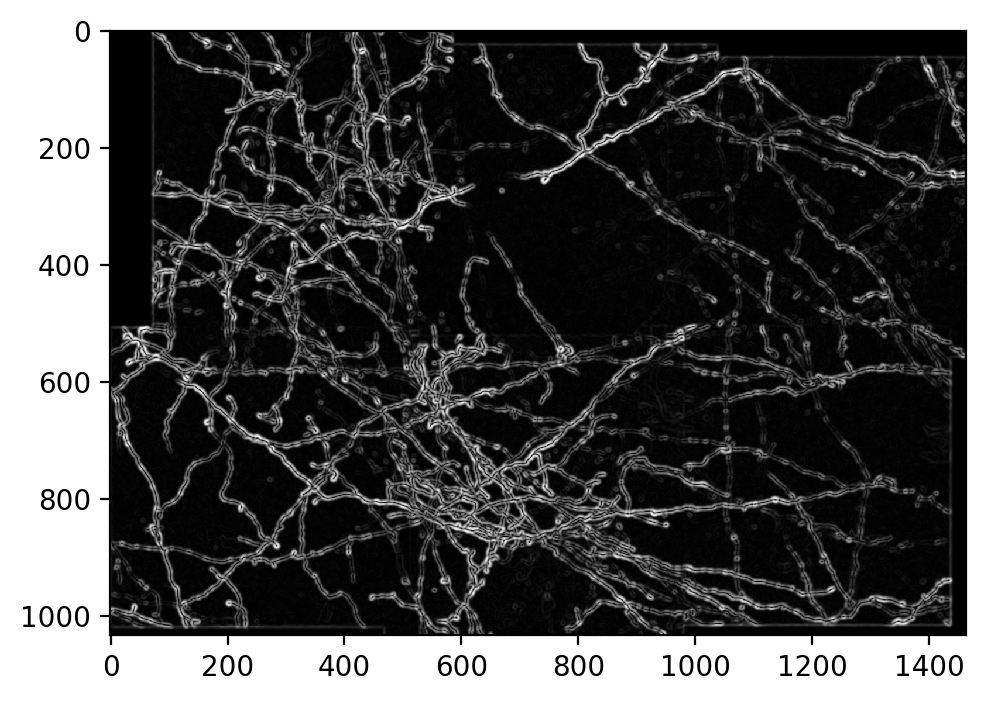

In [13]:
sobel_image = filters.sobel(image)
show_image(sobel_image)

### Hessian Filter

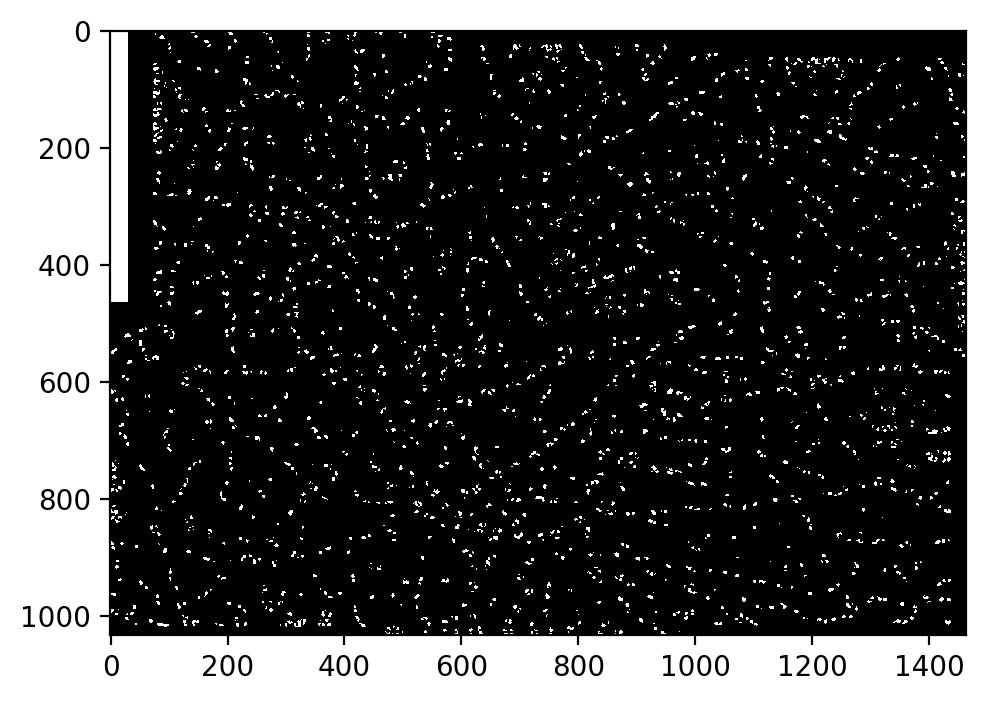

In [14]:
hessian_image = filters.hessian(image)
show_image(hessian_image)

### Mean Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


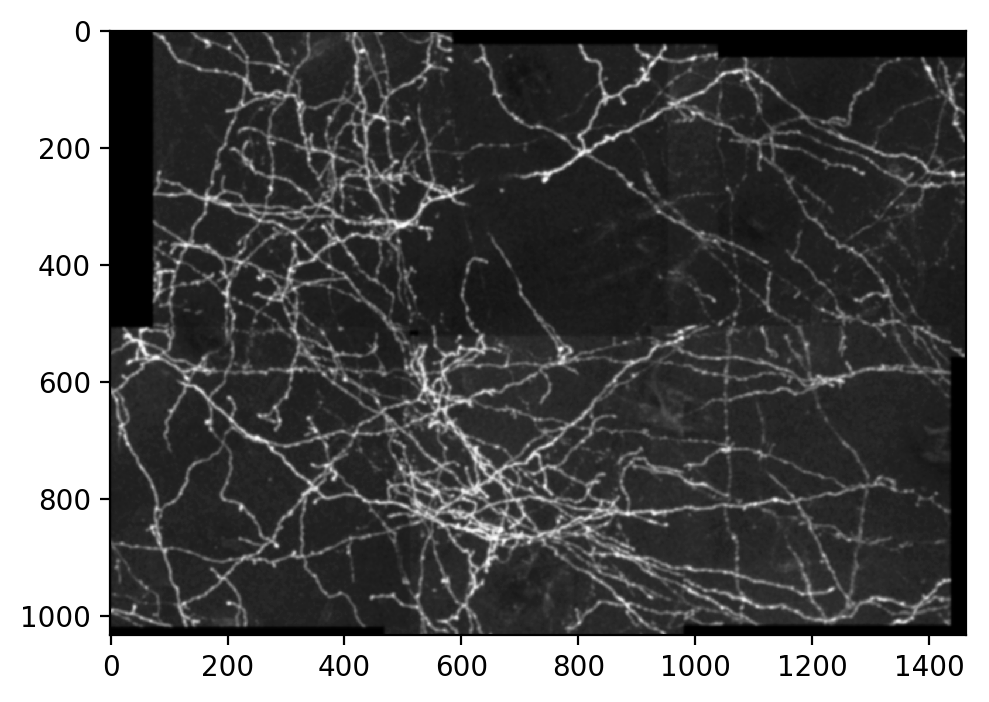

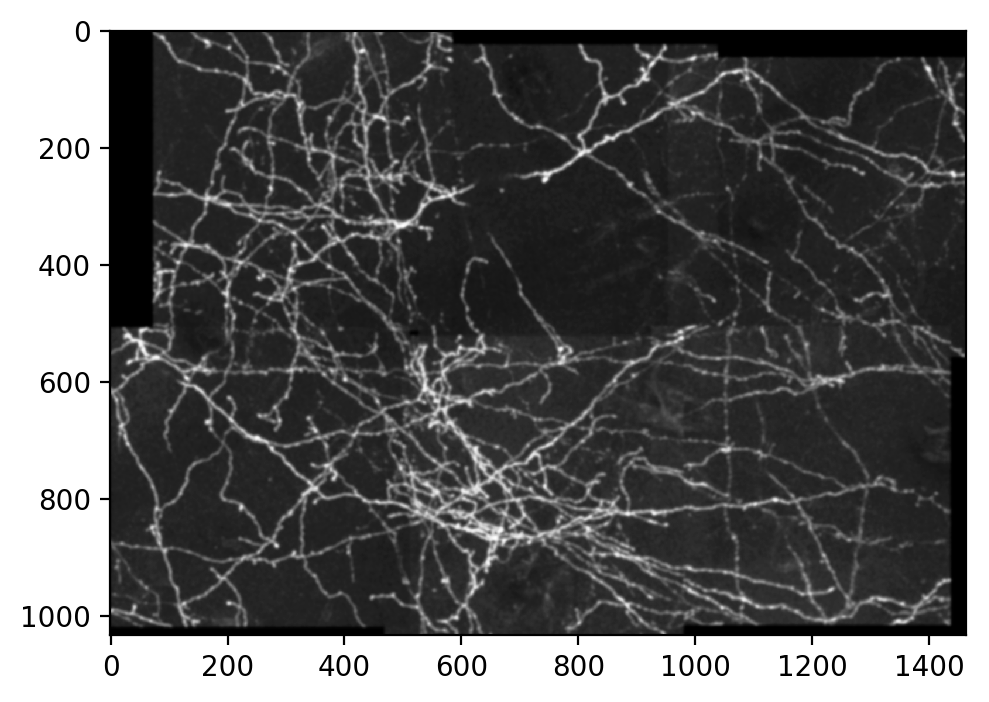

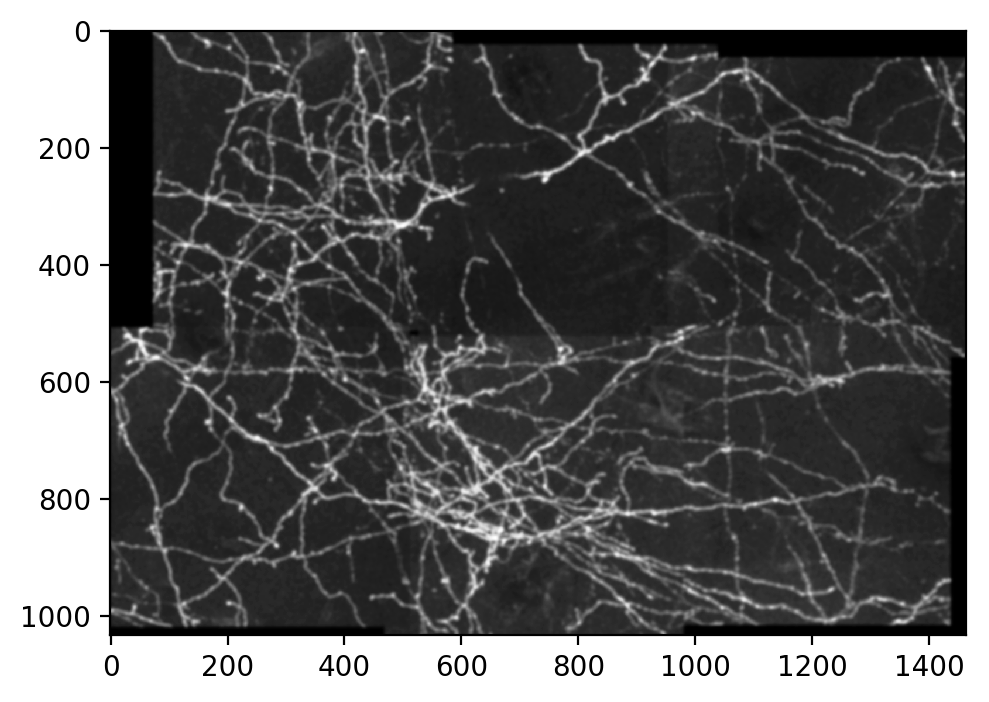

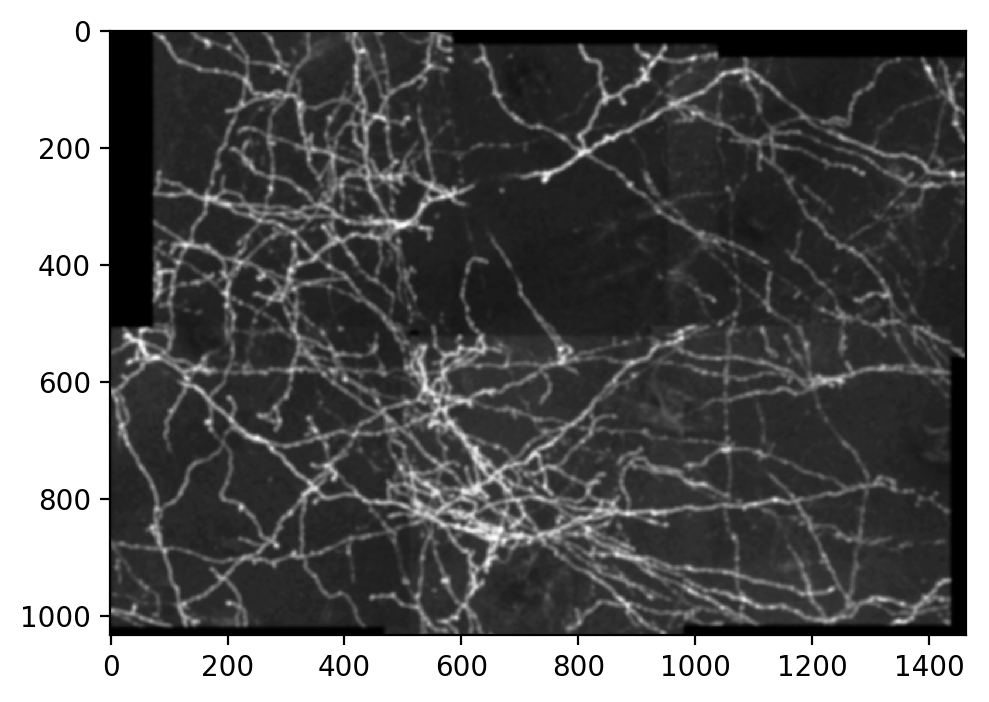

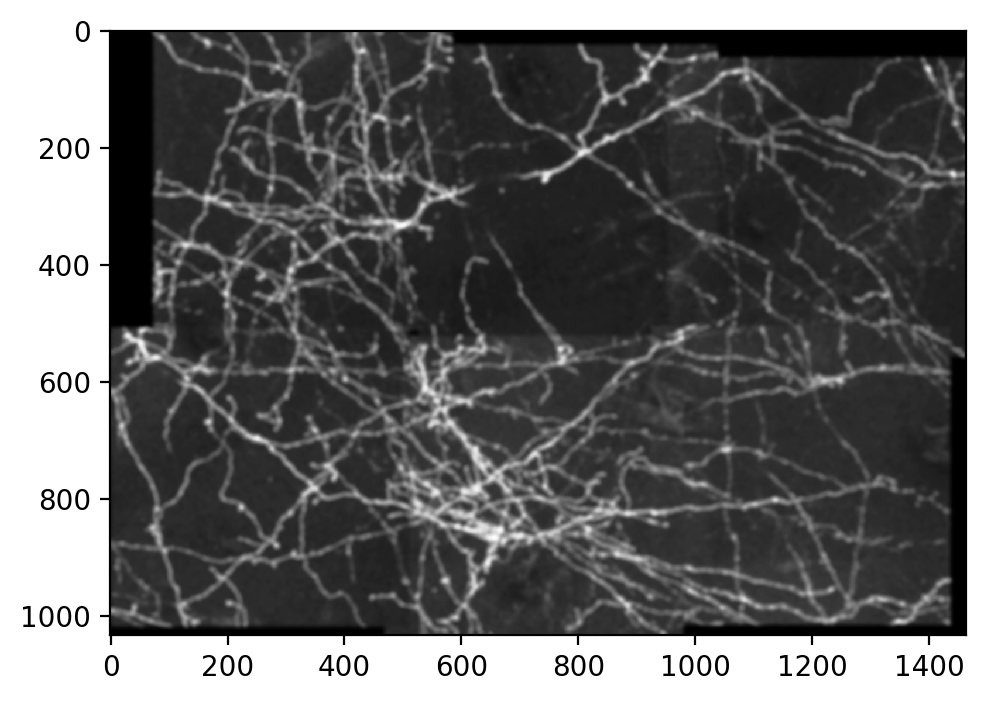

In [15]:
mean_images = []
for i in range(1, max_radius):
    mean_images.append(filters.rank.mean(image, selem=morphology.disk(i)))

for mean_image in mean_images:
    show_image(mean_image)

### Variance Filter

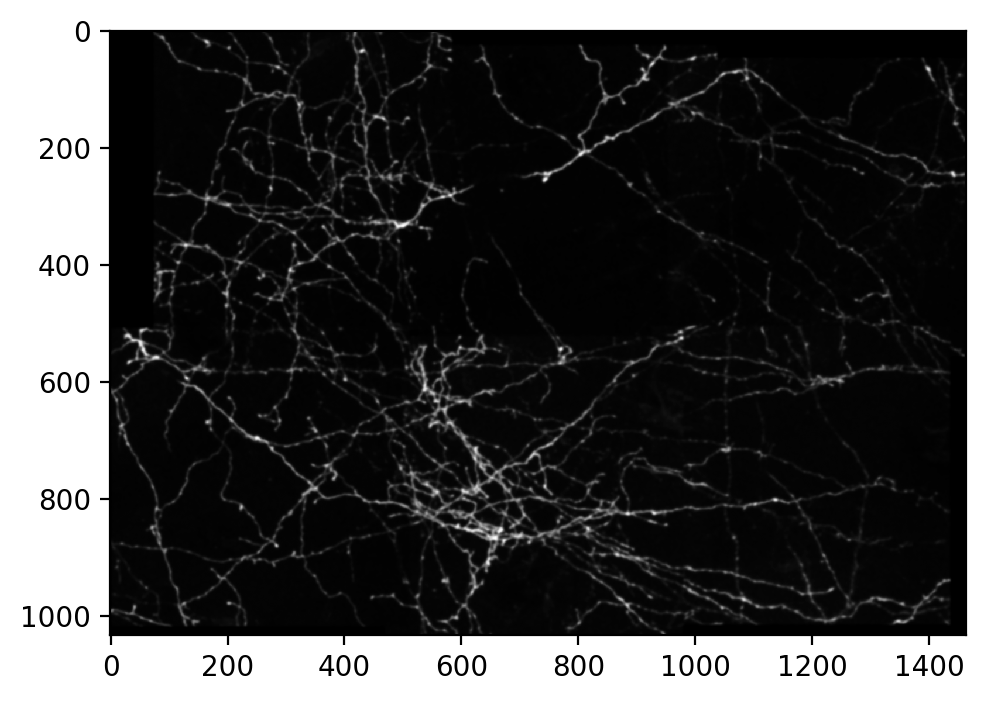

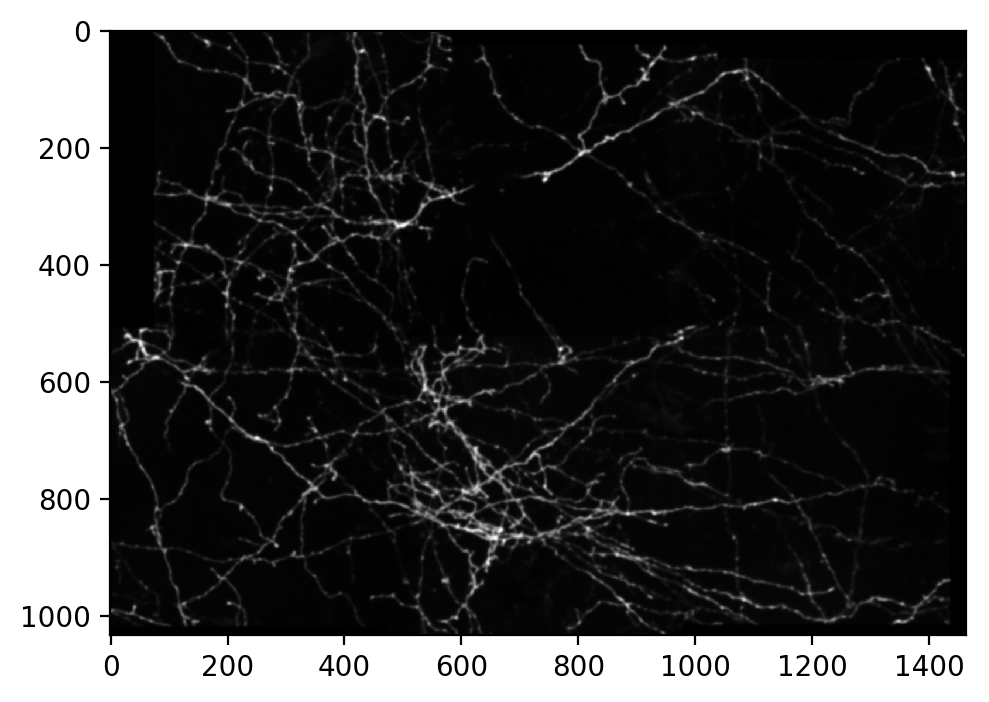

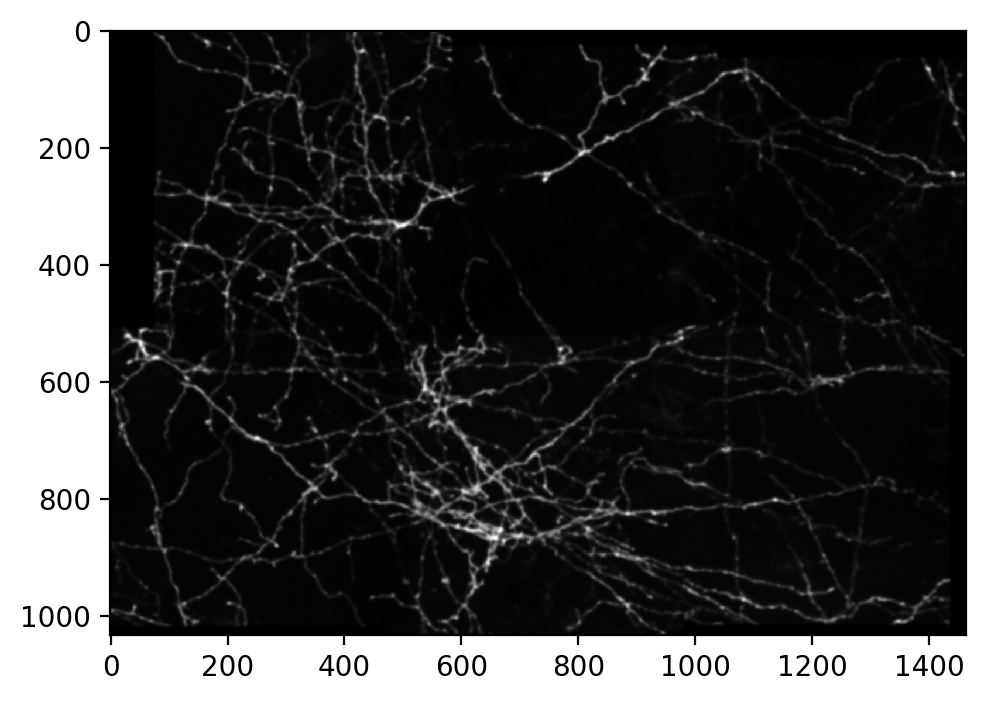

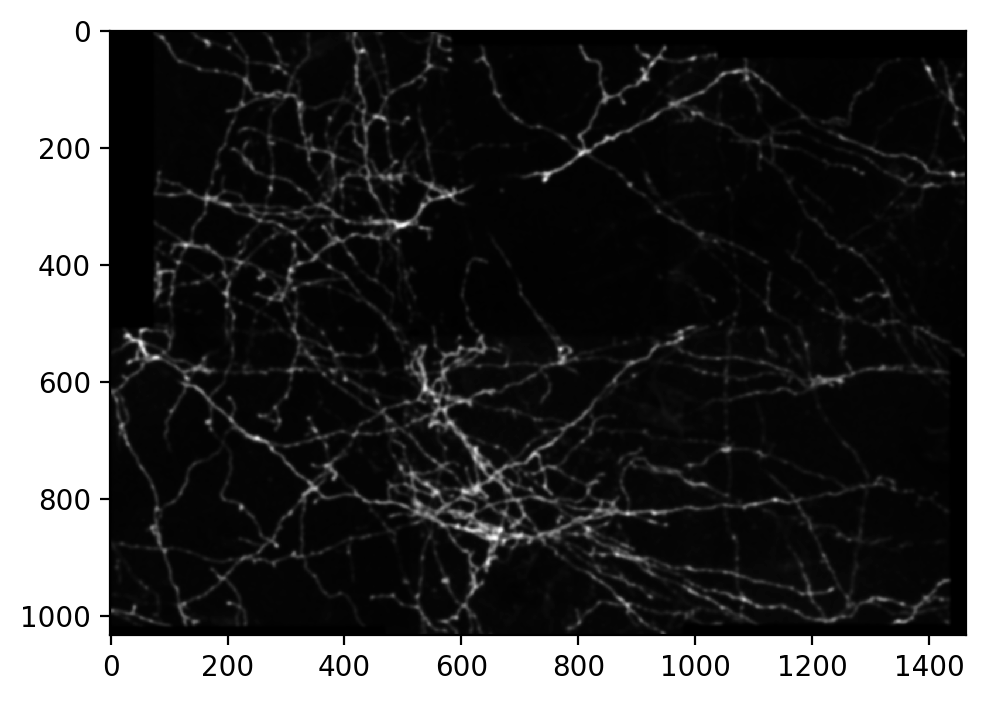

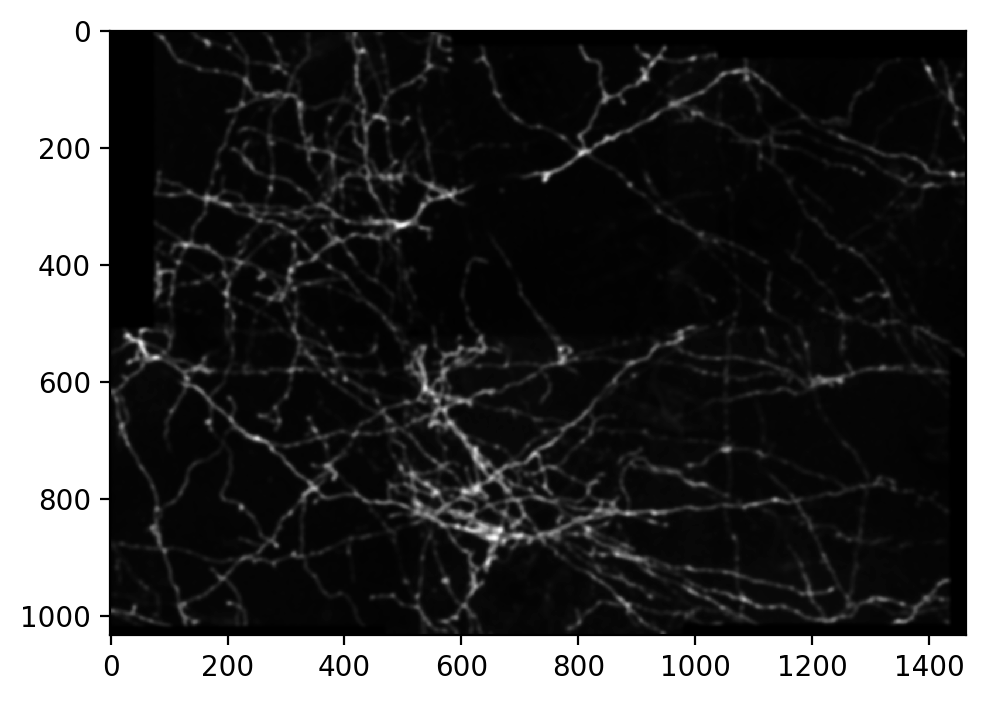

In [16]:
variance_images = []
for mean_image in mean_images:
    variance_images.append(np.power(image-mean_image,2))
    
for variance_image in variance_images:
    show_image(variance_image)

### Median Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


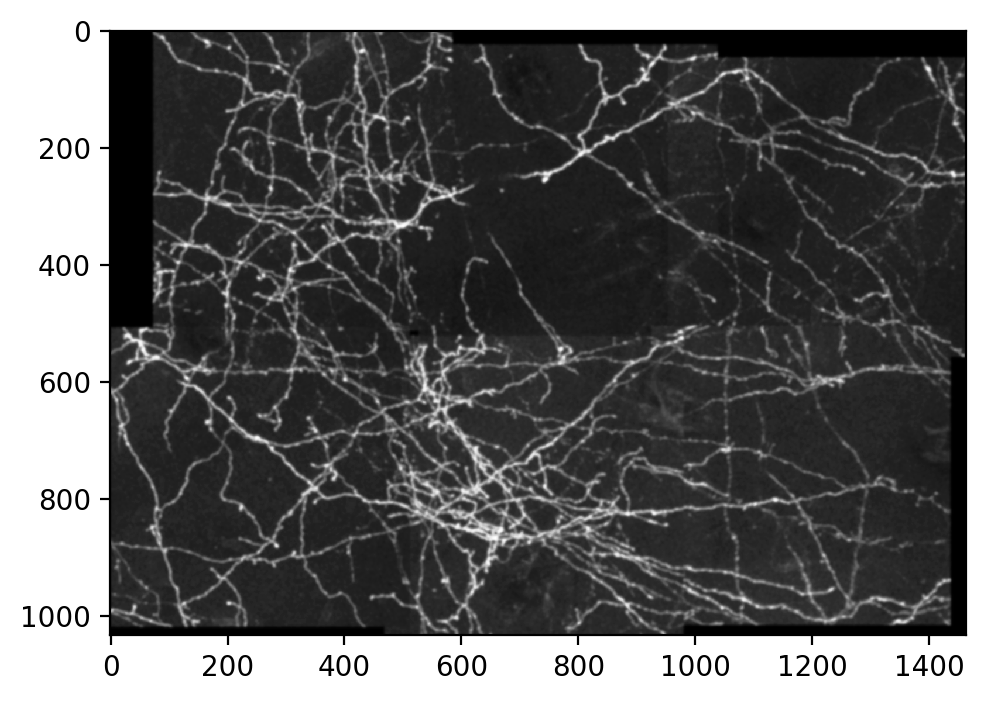

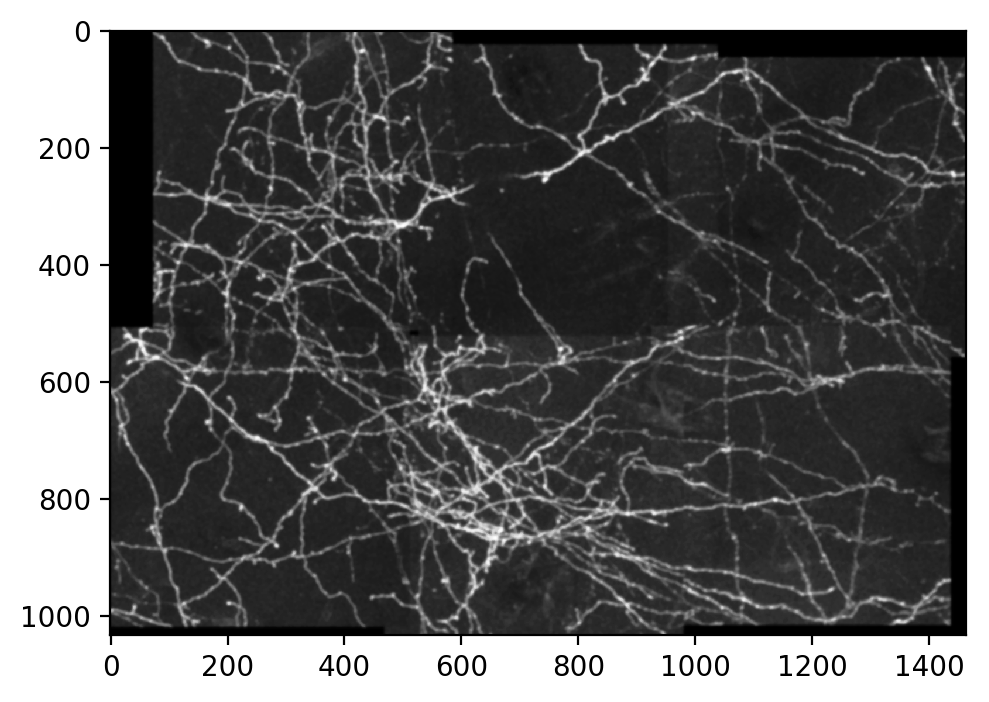

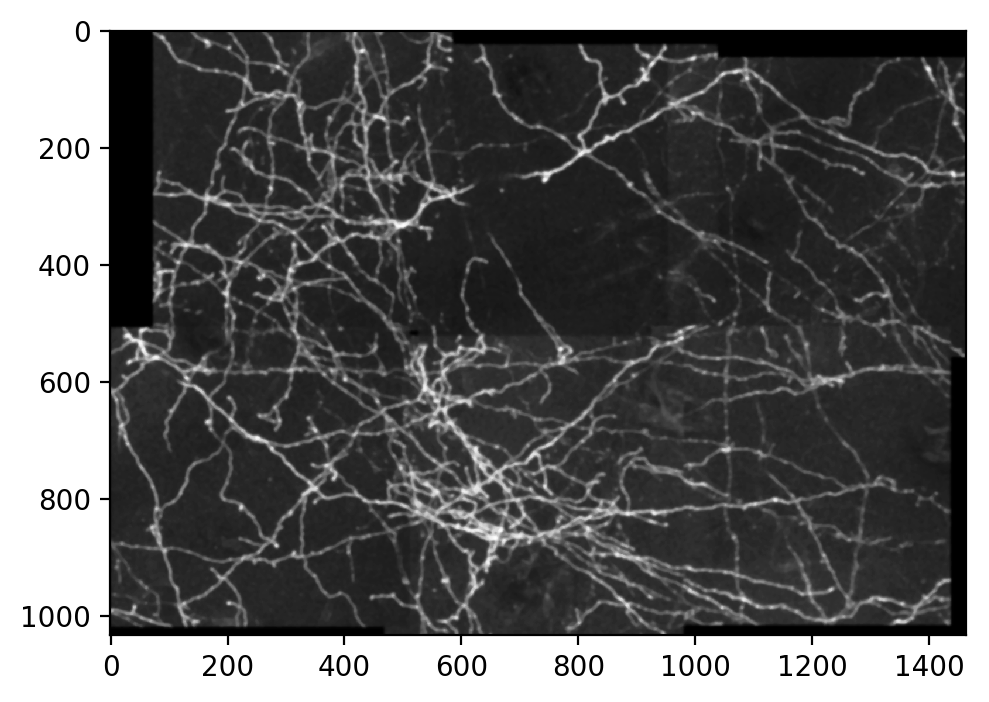

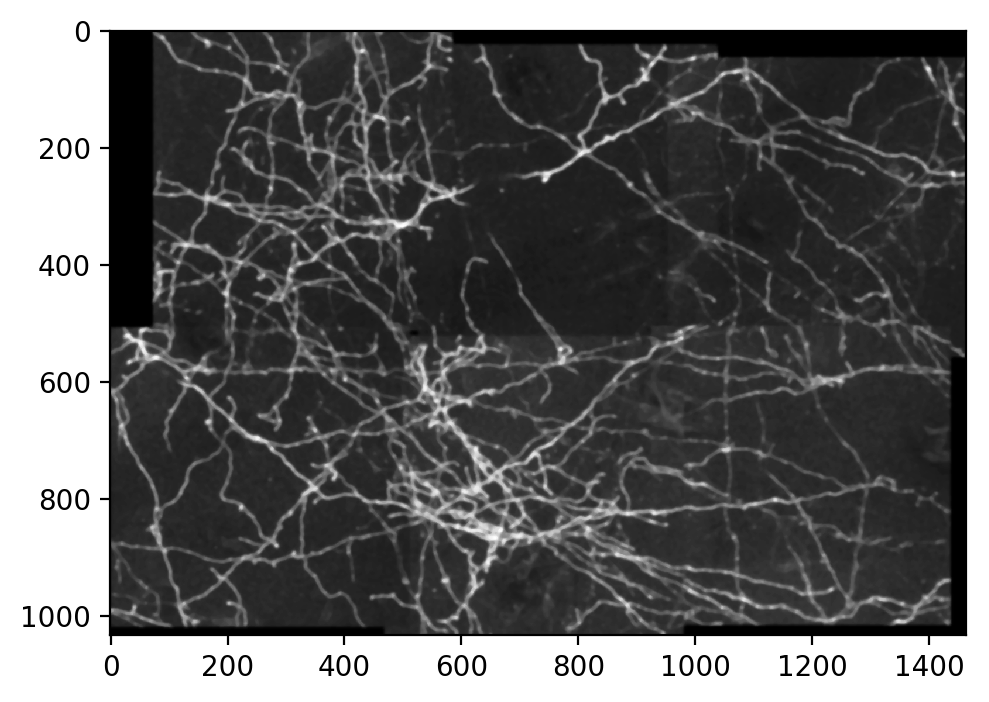

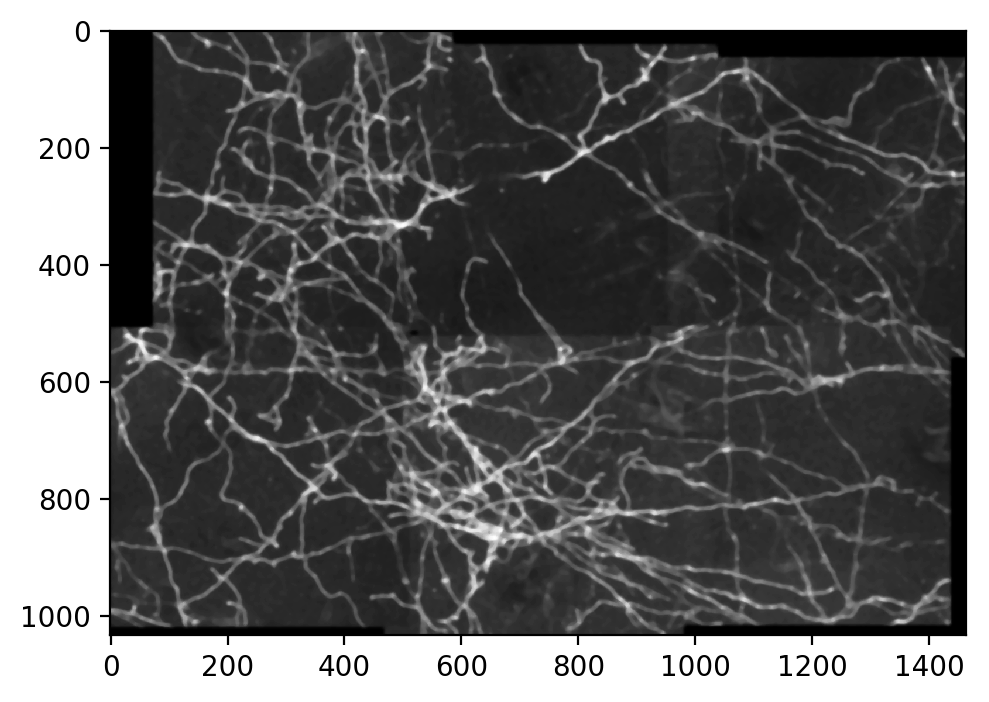

In [17]:
median_images = []
for i in range(1, max_radius):
    median_images.append(filters.rank.median(image, selem=morphology.disk(i)))

for median_image in median_images:
    show_image(median_image)

### Minimum Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


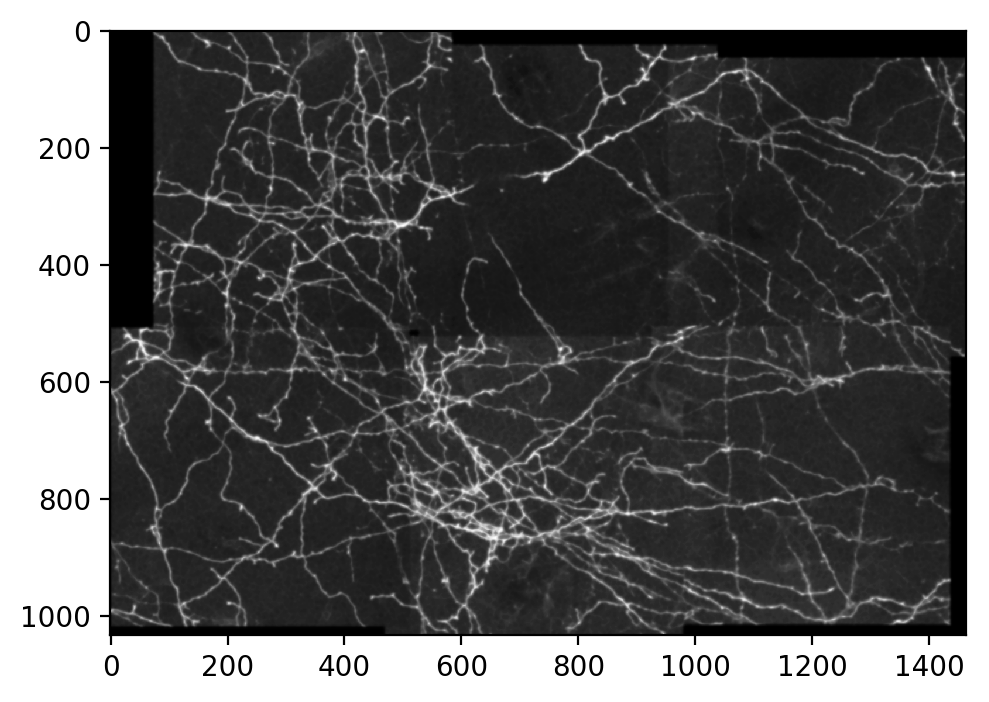

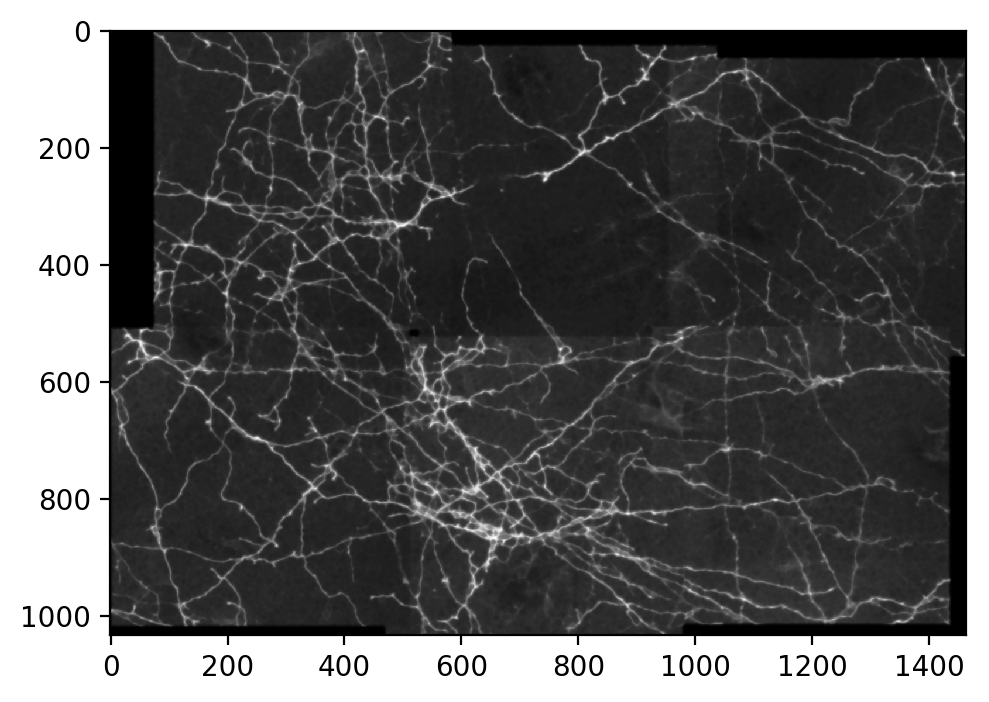

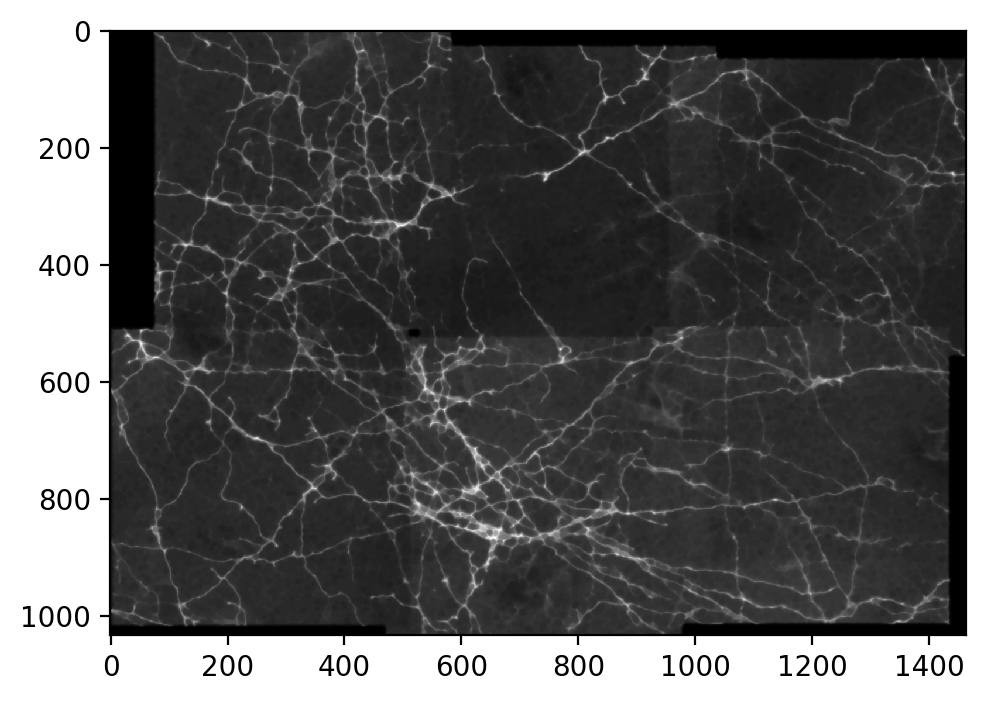

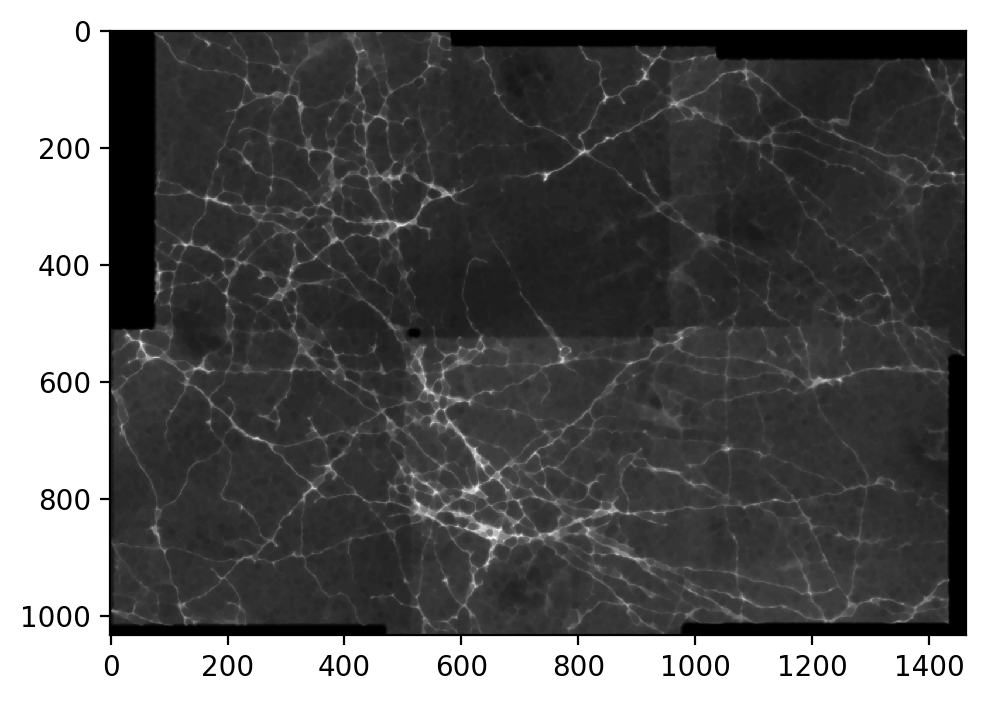

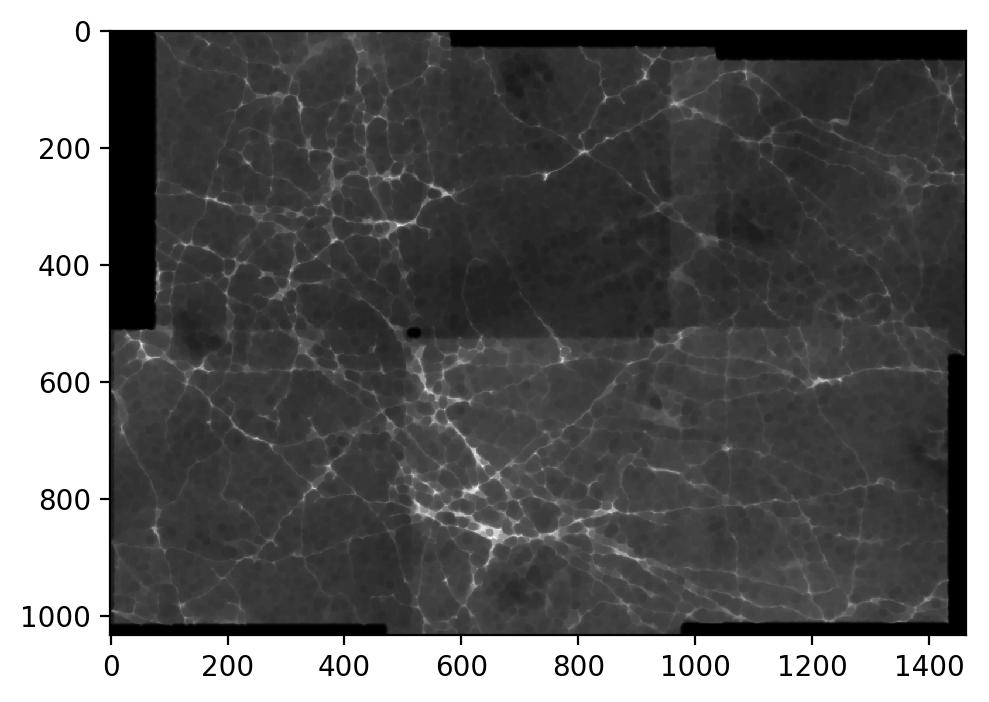

In [18]:
minimum_images = []
for i in range(1, max_radius):
    minimum_images.append(filters.rank.minimum(image, selem=morphology.disk(i)))

for minimum_image in minimum_images:
    show_image(minimum_image)

### Maximum Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


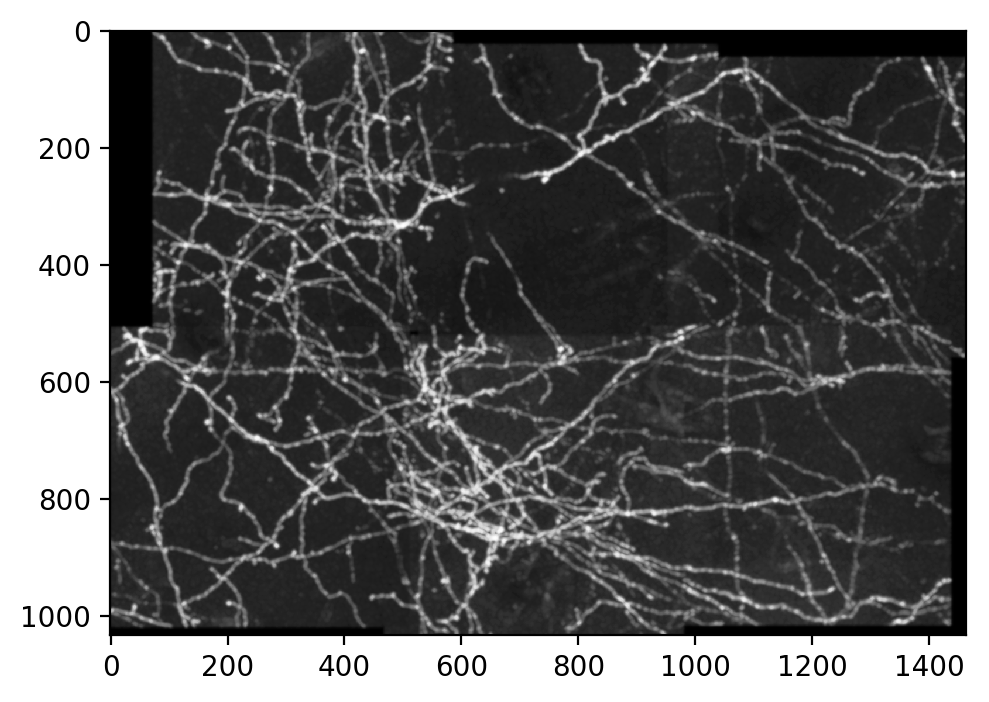

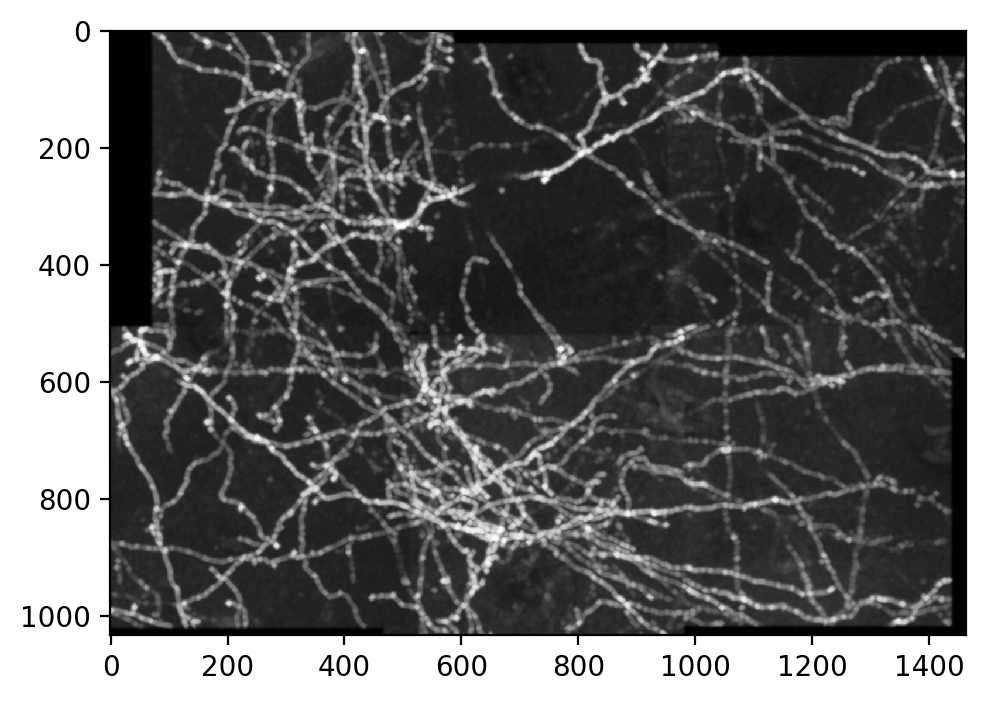

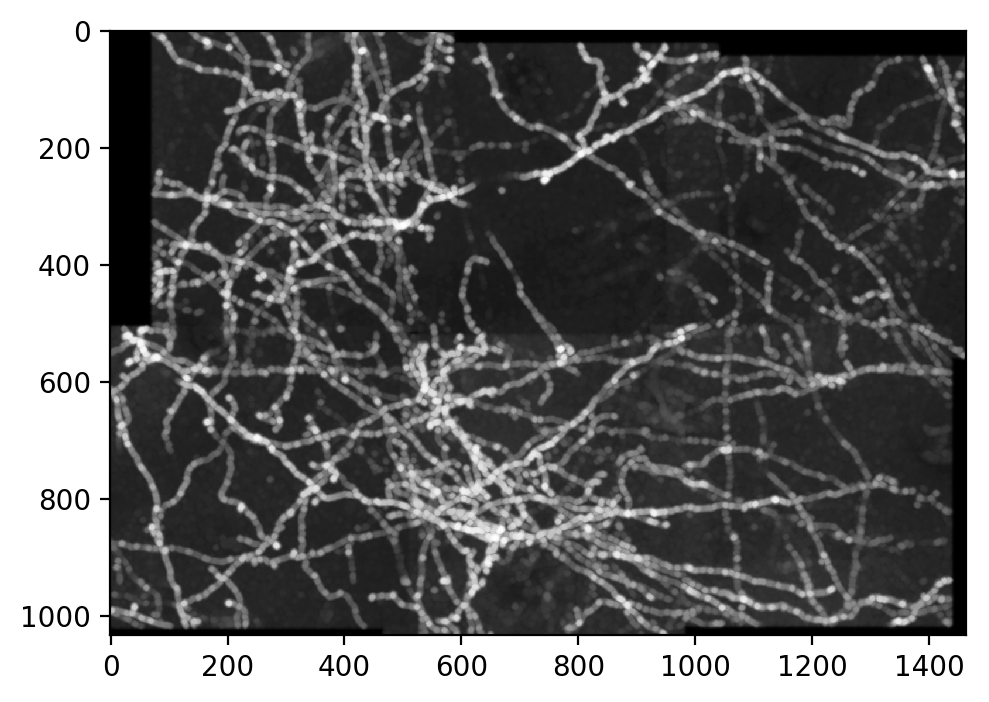

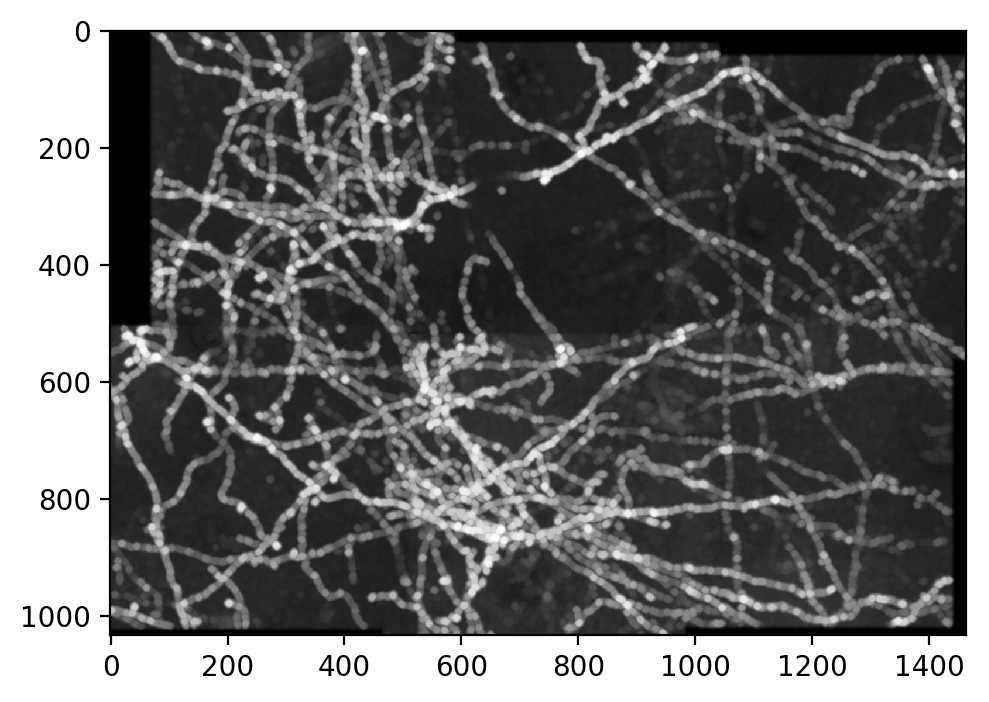

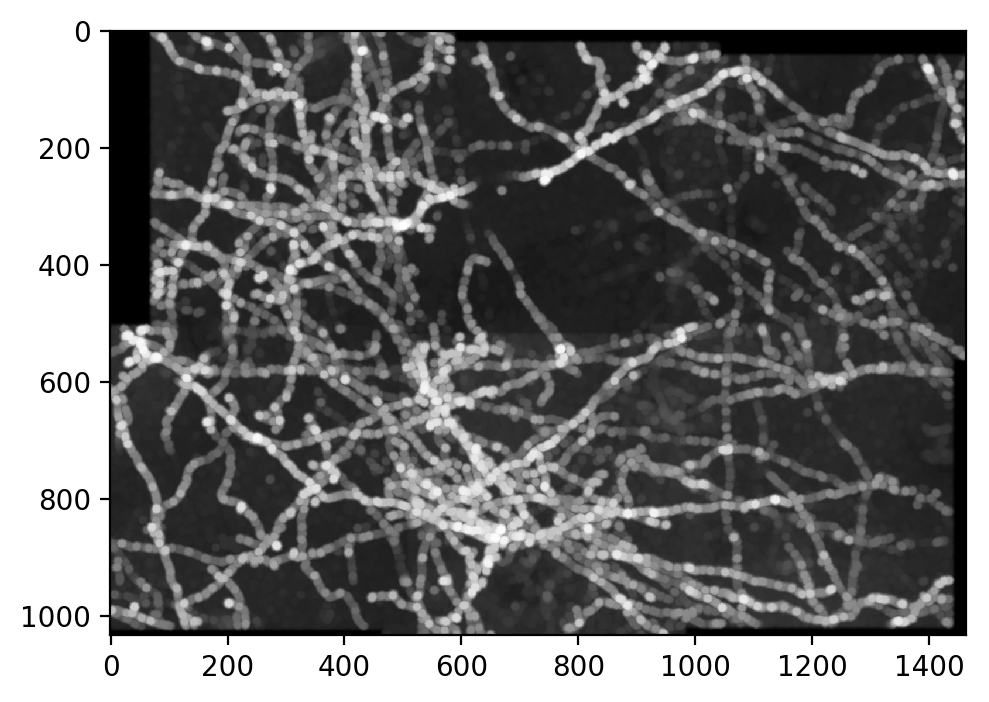

In [19]:
maximum_images = []
for i in range(1, max_radius):
    maximum_images.append(filters.rank.maximum(image, selem=morphology.disk(i)))

for maximum_image in maximum_images:
    show_image(maximum_image)

### Anisotropic Diffusion

In [20]:
# TODO

### Bilateral Filter

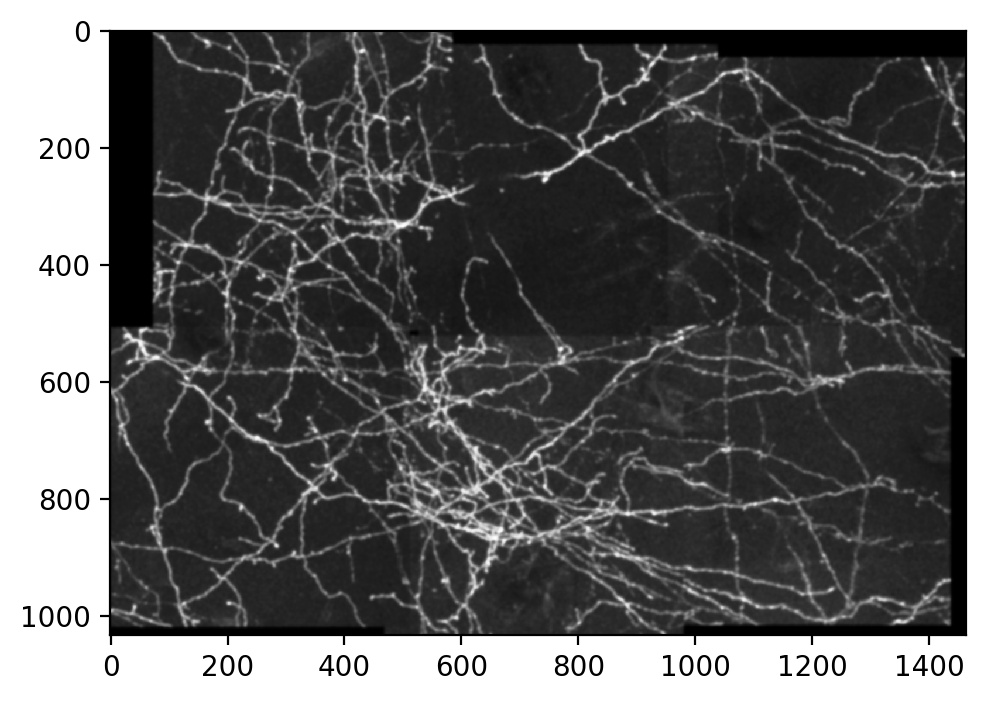

In [21]:
# TODO ensure parameters match the Weka specification (I'm just using the defaults for now)
bilateral_image = restoration.denoise_bilateral(image, win_size=None, sigma_color=None, sigma_spatial=1, bins=10000, mode='constant', cval=0, multichannel=False)
show_image(bilateral_image)

### Lipschitz Filter

In [22]:
# TODO


### Kuwahara Filter

In [23]:
# TODO


### Gabor Filter

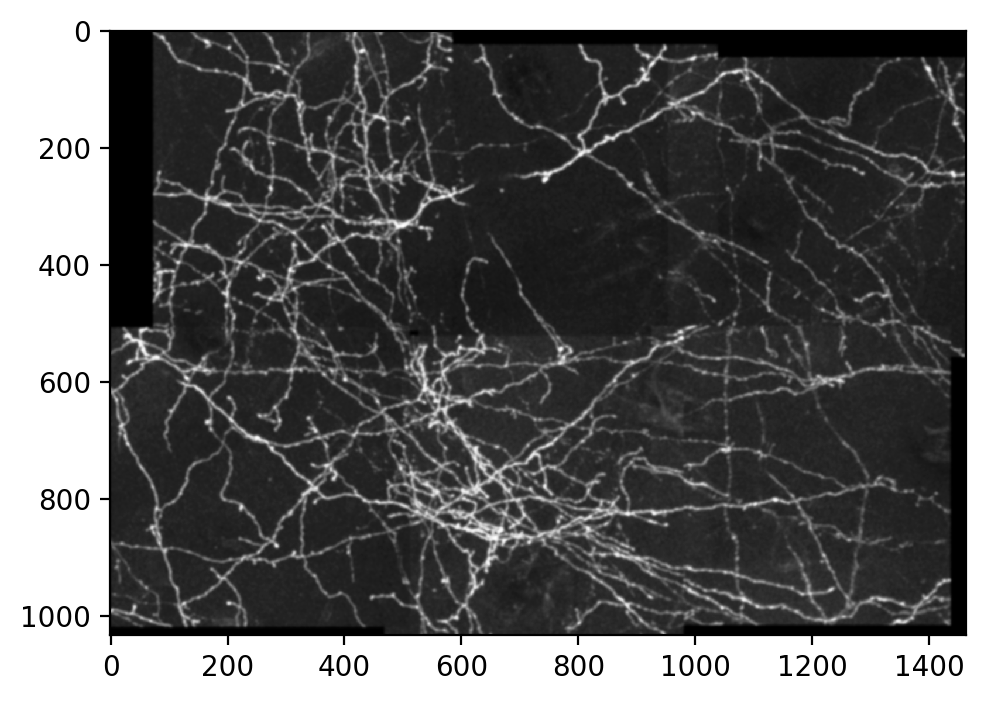

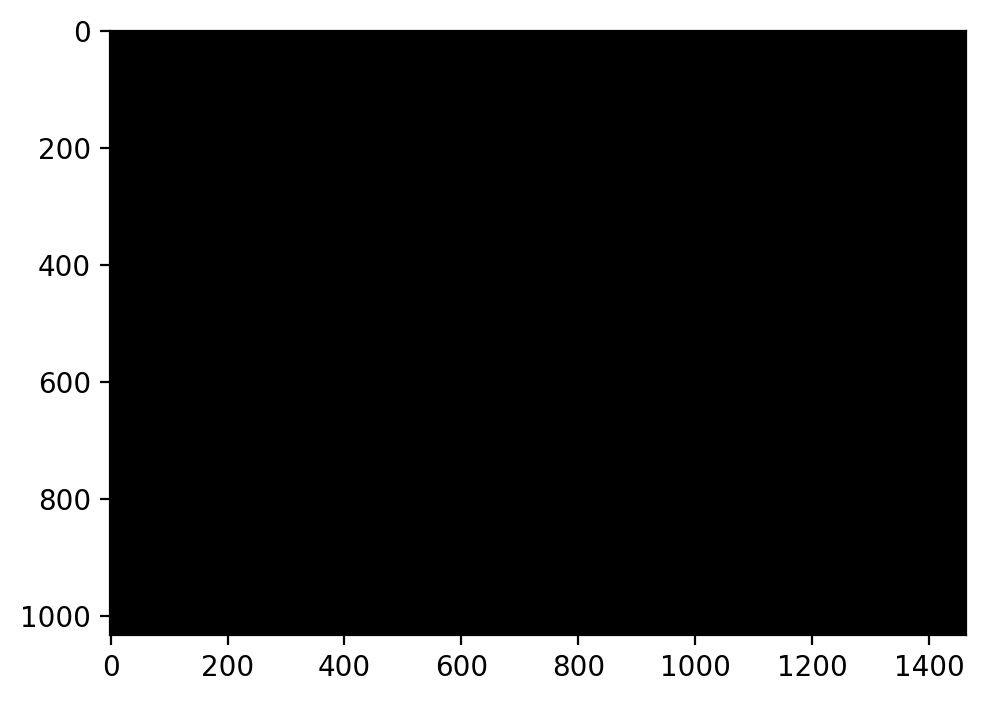

In [24]:
# TODO: learn more about this filter and what values to use for frequency.
gabor_real_image, gabor_imaginary_image = filters.gabor(image, frequency=3, theta=0, bandwidth=1, sigma_x=None, sigma_y=None, n_stds=3, offset=0, mode='reflect', cval=0)
show_image(gabor_real_image)
show_image(gabor_imaginary_image)

### Derivative Filters

In [25]:
# TODO

### Laplacian Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/restoration/uft.py:447: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  impr[([slice(1, 2)] * ndim)] = 2.0 * ndim


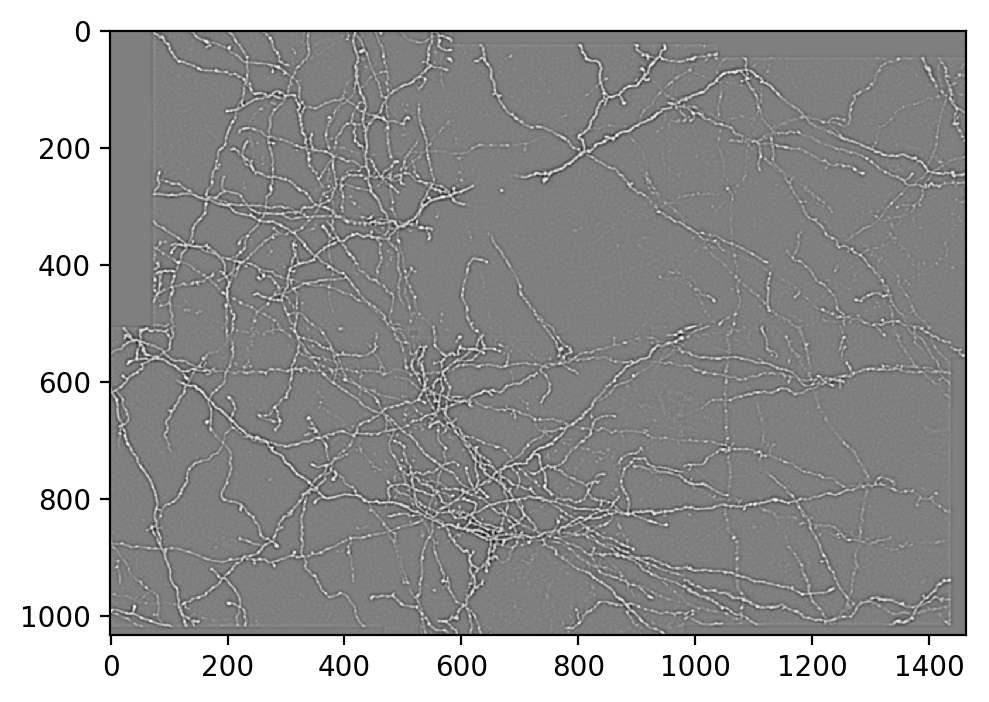

In [26]:
laplace_image = filters.laplace(image, ksize=3)
show_image(laplace_image)
fname_laplacian_raw = fname.rsplit('.', 1)[0] + '_laplacian.raw'
laplace_image.astype('float32').tofile(fname_laplacian_raw)

### Structure Filter

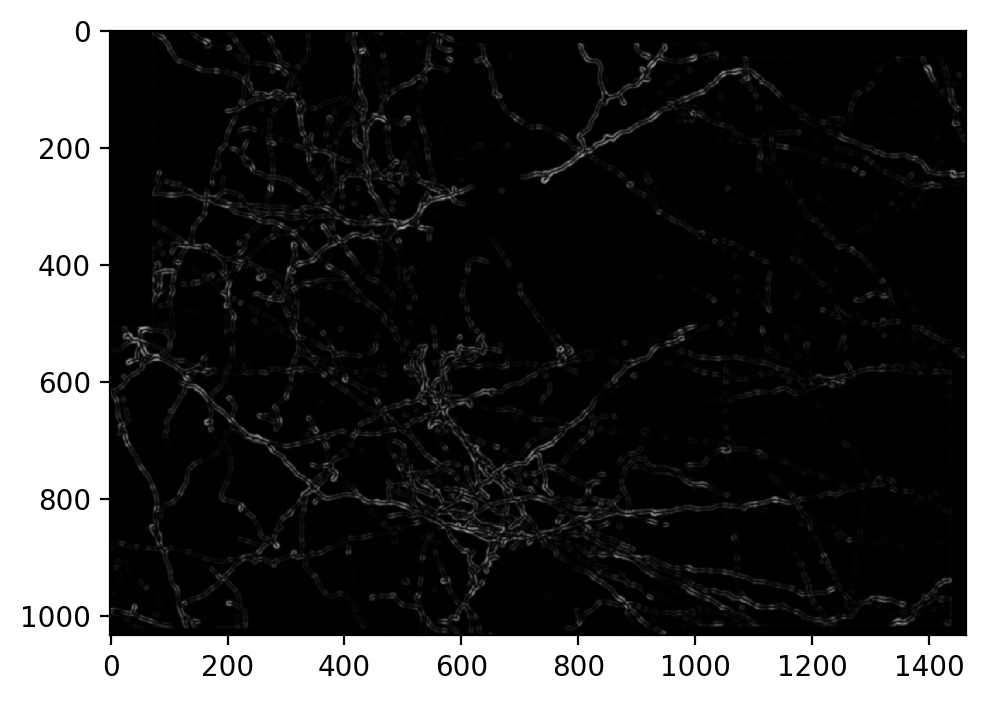

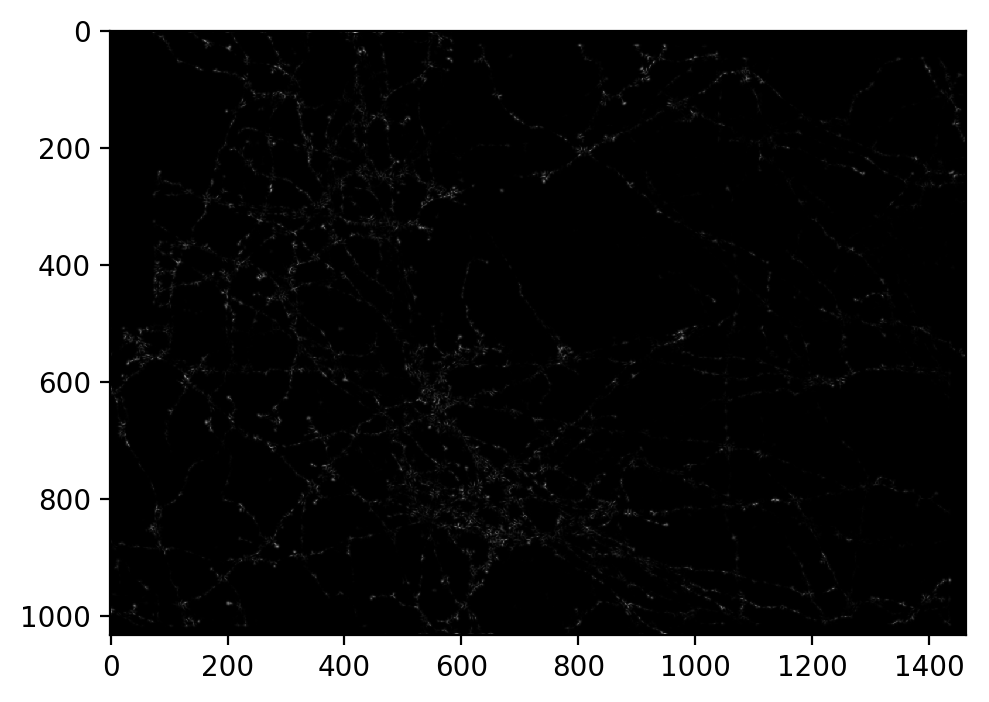

In [27]:
structure_tensor = feature.structure_tensor(image, sigma=1, mode='constant', cval=0)
largest_eig_image = np.zeros(shape=image.shape)
smallest_eig_image = np.zeros(shape=image.shape)
for row in range(structure_tensor[0].shape[0]):
    for col in range(structure_tensor[0].shape[1]):
        Axx = structure_tensor[0][row, col]
        Axy = structure_tensor[1][row, col]
        Ayy = structure_tensor[2][row, col]
        eigs = np.linalg.eigvals([[Axx, Axy], [Axy, Ayy]])
        largest_eig_image[row, col] = np.max(eigs)
        smallest_eig_image[row, col] = np.min(eigs)
        
show_image(largest_eig_image)
show_image(smallest_eig_image)

### Entropy Filter

/home/maljovec/anaconda3/envs/regulus/lib/python3.7/site-packages/skimage/util/dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


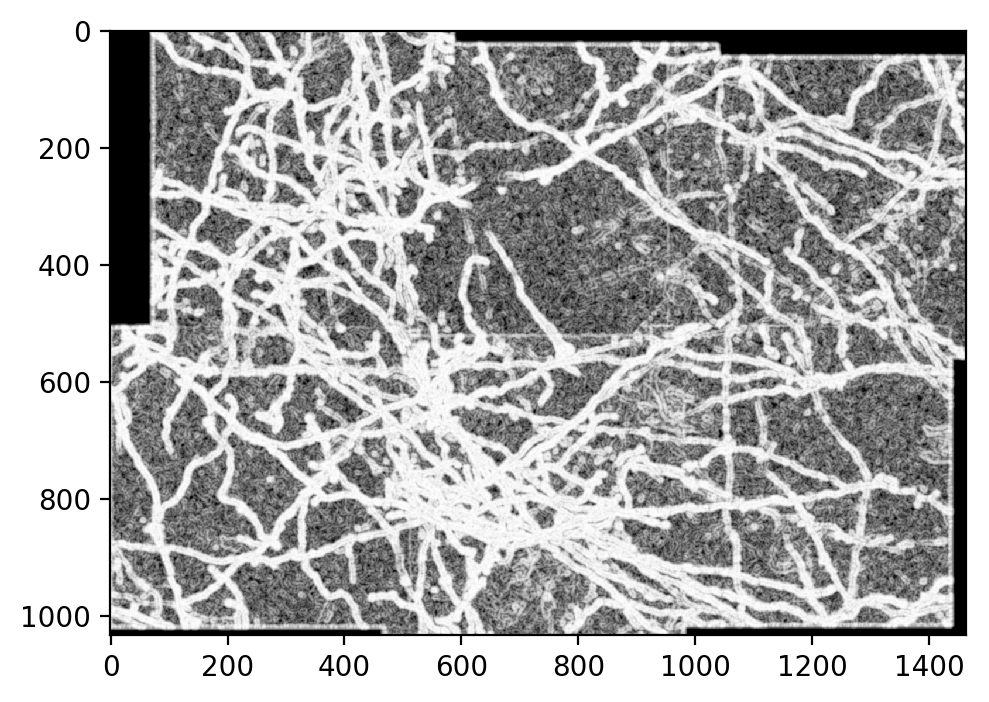

In [28]:
entropy_image = filters.rank.entropy(image, selem=morphology.disk(3))
show_image(entropy_image)

### Neighbors

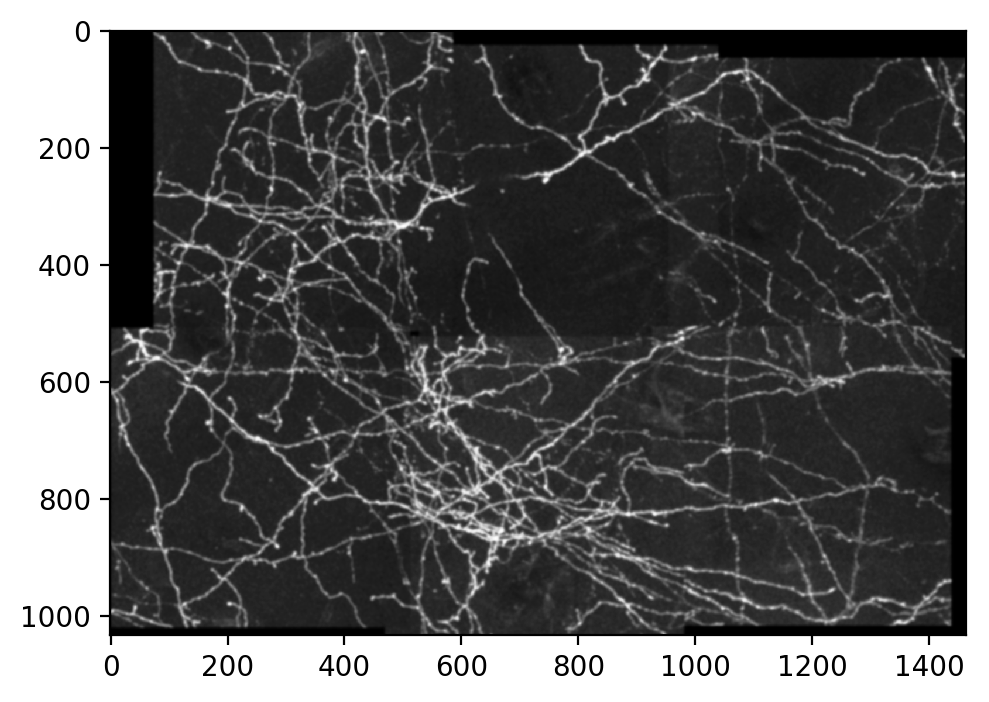

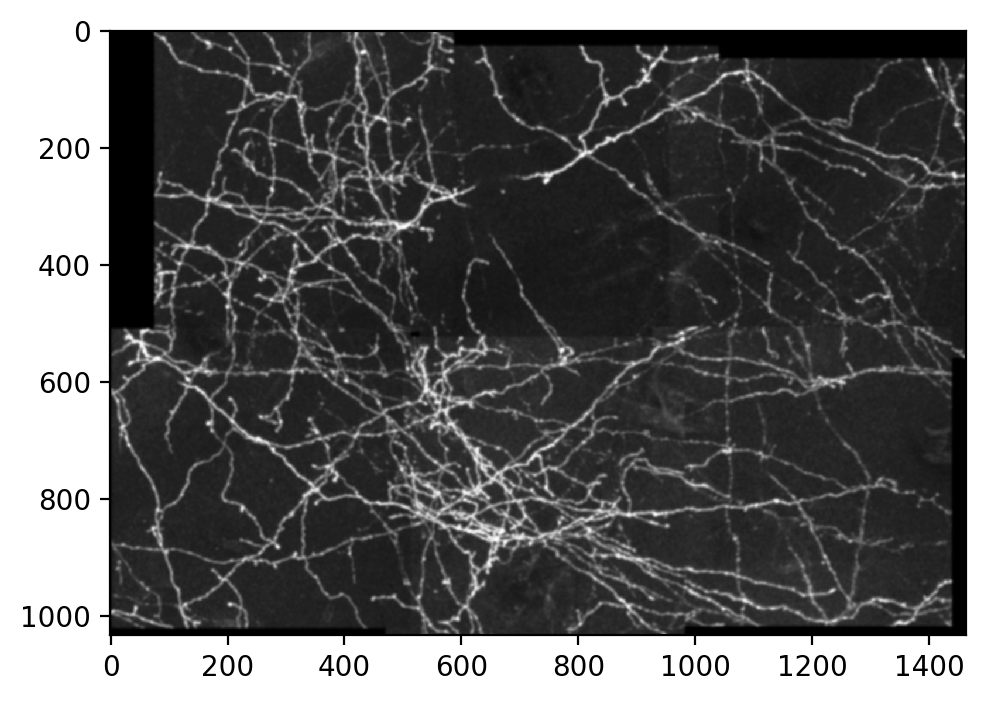

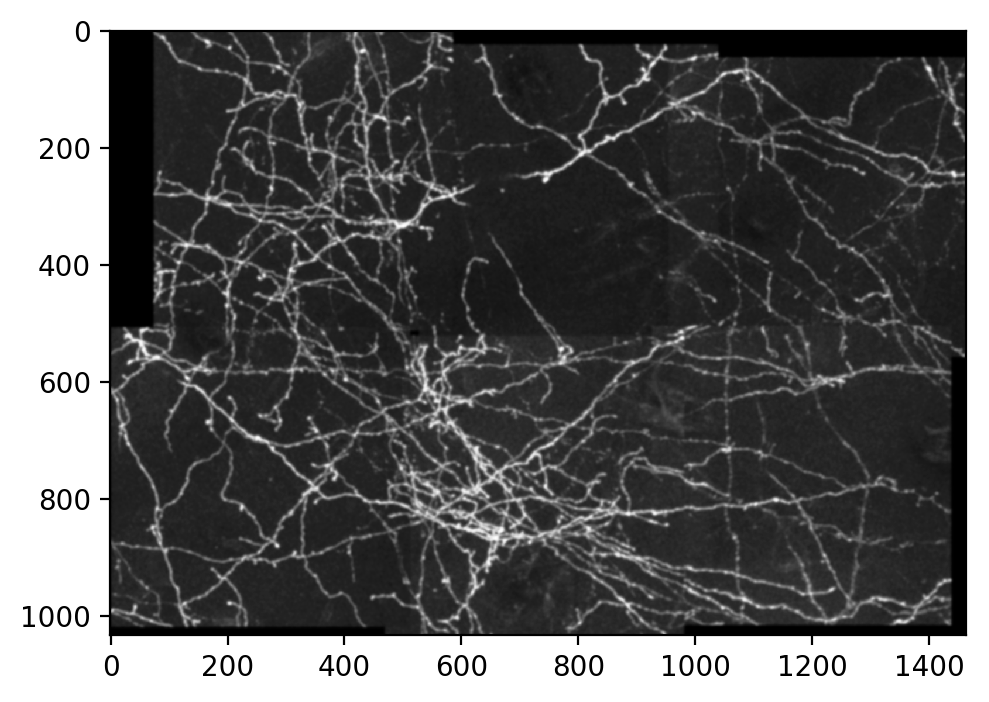

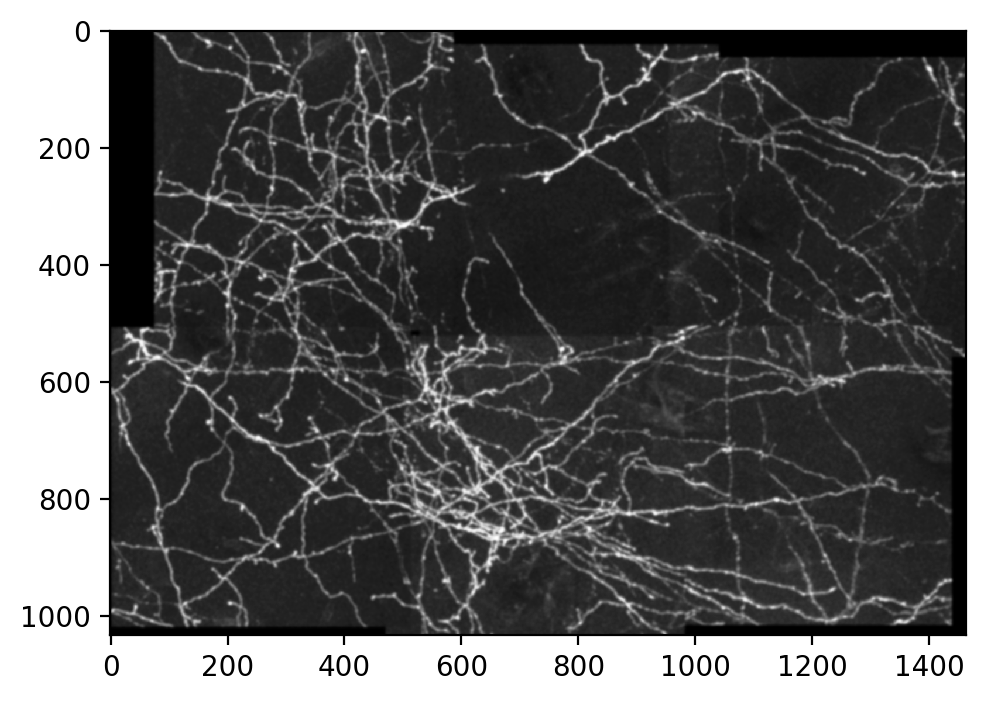

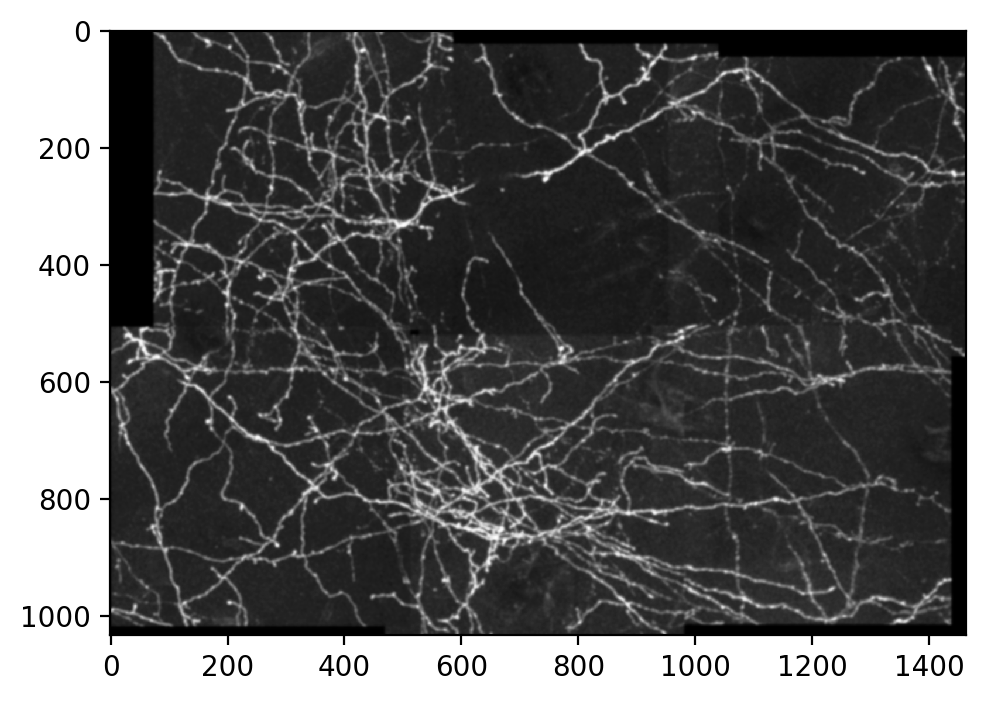

...

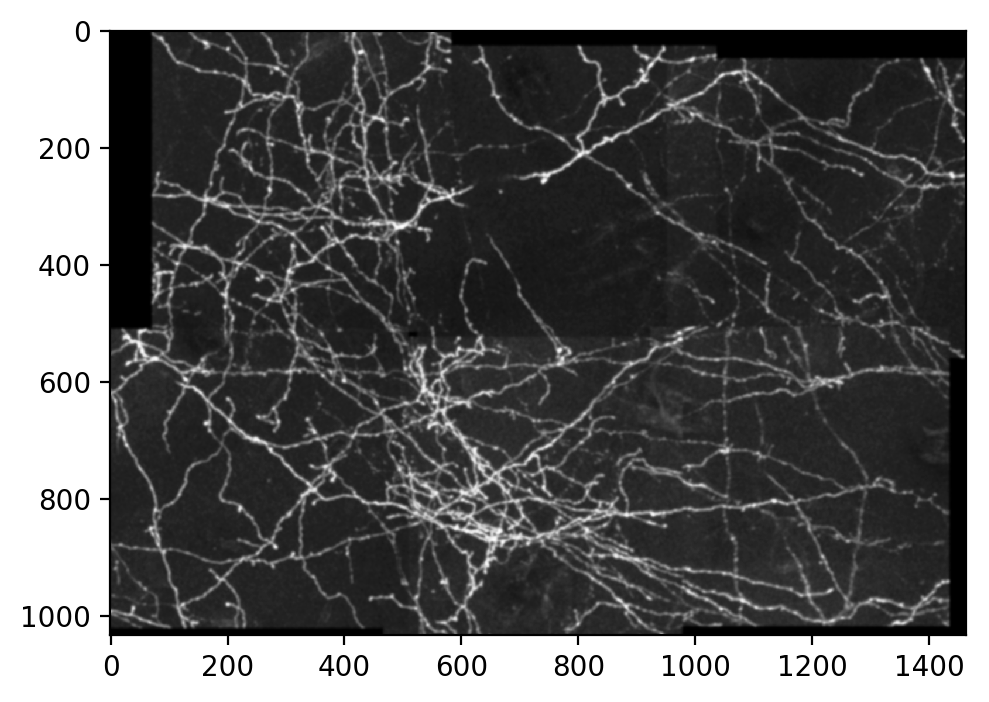

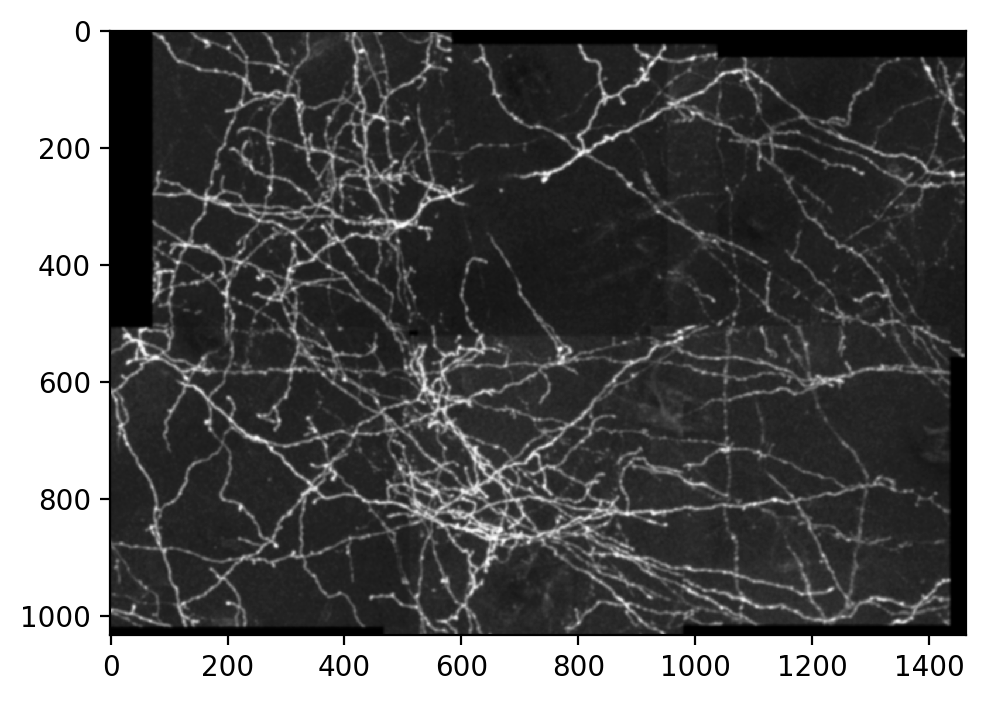

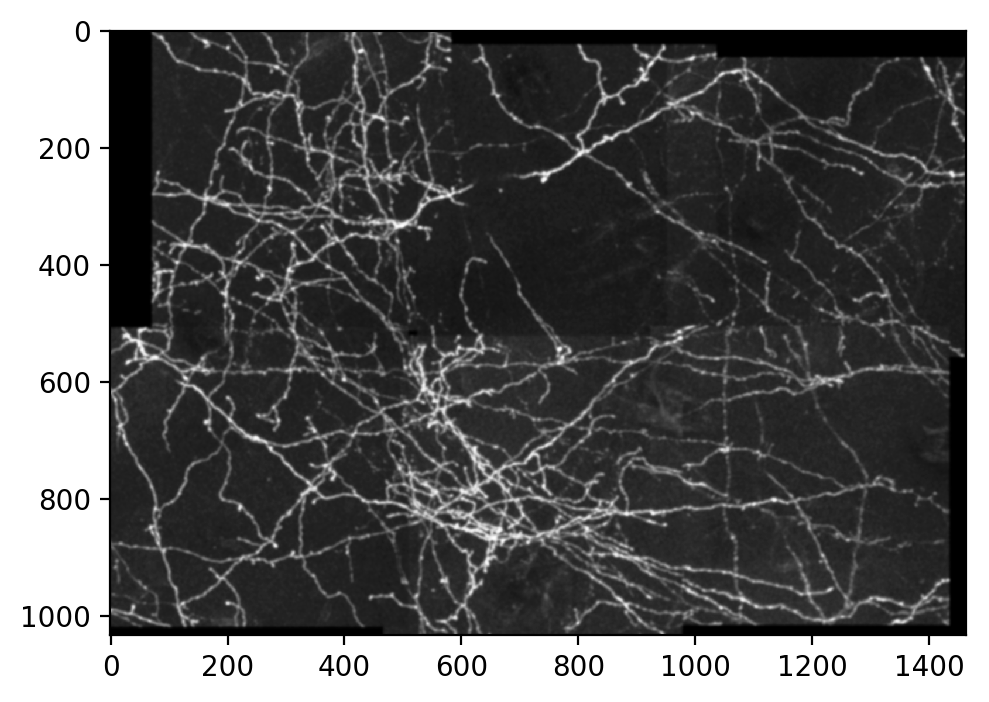

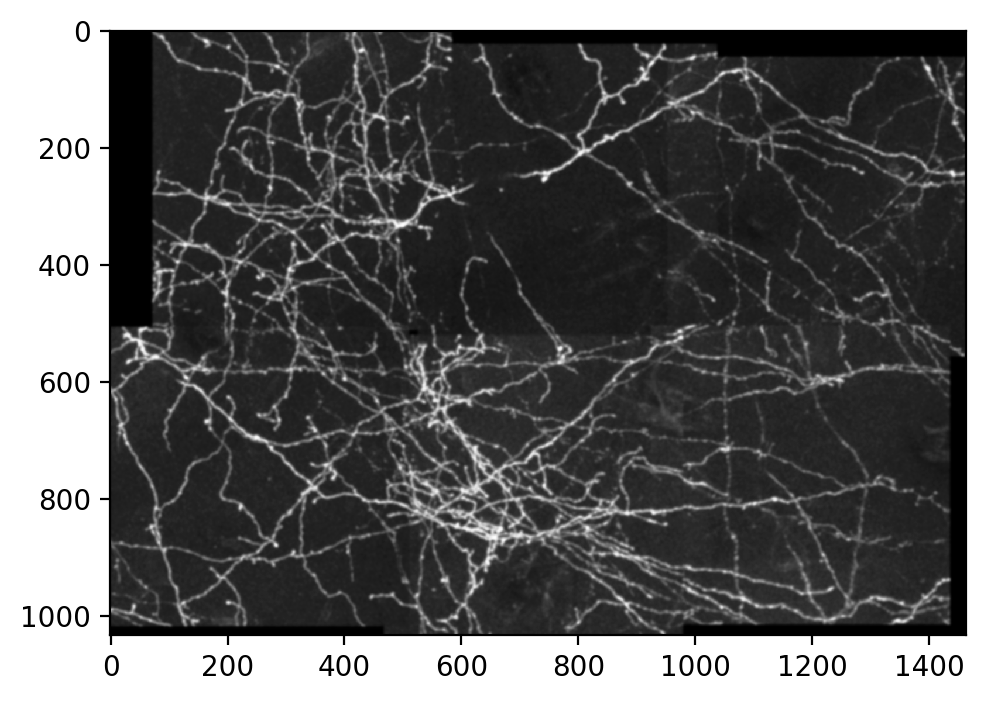

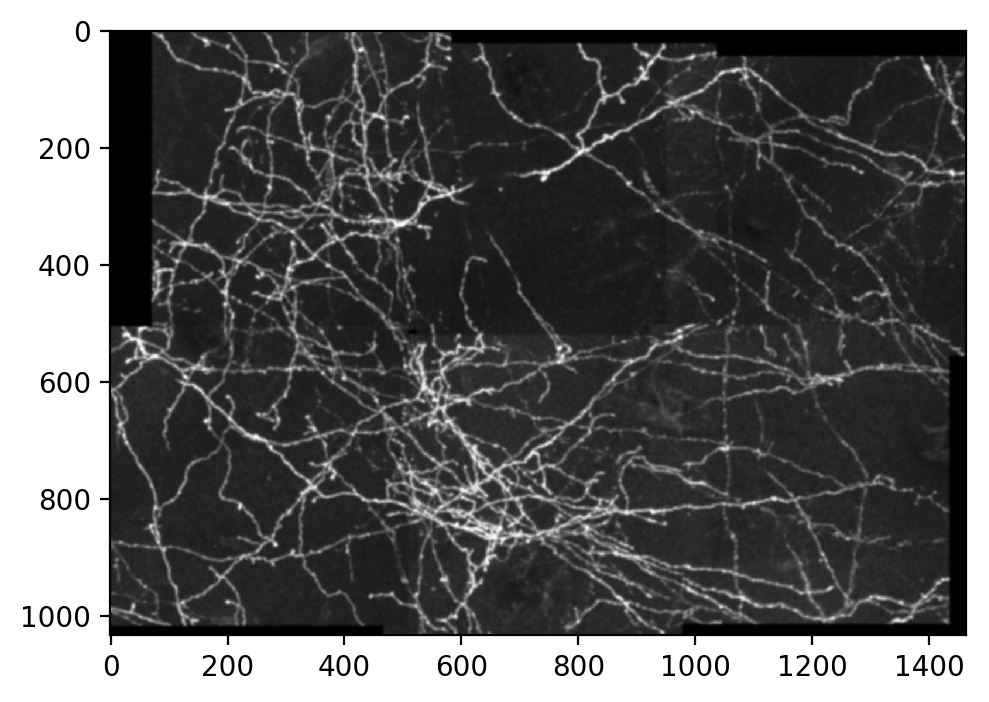

In [29]:
neighbor_images = []
directions = [(-1,-1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
sigma = 1

for t in directions:
    for sigma in range(1, max_shift):
        tform = transform.SimilarityTransform(scale=1, rotation=0, translation=tuple([sigma*val for val in t]))
        neighbor_images.append(transform.warp(image, tform))
        
for neighbor_image in neighbor_images:
    show_image(neighbor_image)

# Loading the Morse-Smale Complex

In [31]:
proc = subprocess.Popen([os.path.join('..','..','MSCvisus','MSCTest2DViewer','test_2d_viewer'),
                                fname_raw,
                                str(image.shape[1]),
                                str(image.shape[0]),
                                "1",
                                "1",
                                str(persistence_coarse)],
                               stdin=subprocess.PIPE,
                               stdout=subprocess.PIPE,
                               stderr=subprocess.PIPE)
stdout, stderr = proc.communicate()
print(stdout.decode("utf-8"))
print(stderr.decode("utf-8"))
test_msc_coarse = MSC()
test_msc_coarse.read_from_file(fname_raw)
print('Arc count for p={}: {}'.format(persistence_coarse, len(test_msc_coarse.arcs)))

0=../../MSCvisus/MSCTest2DViewer/test_2d_viewer
1=max_diadem_smoothed.raw
2=1464
3=1033
4=1
5=1
6=8.5
stest=1512312
Computing discrete gradient: 
Gothere
neighbor=2928
maxval = 0.717353, looky = 0.060975, num = 26366
pos is 24494
writing nodes
writing arcs


Arc count for p=8.5: 7461


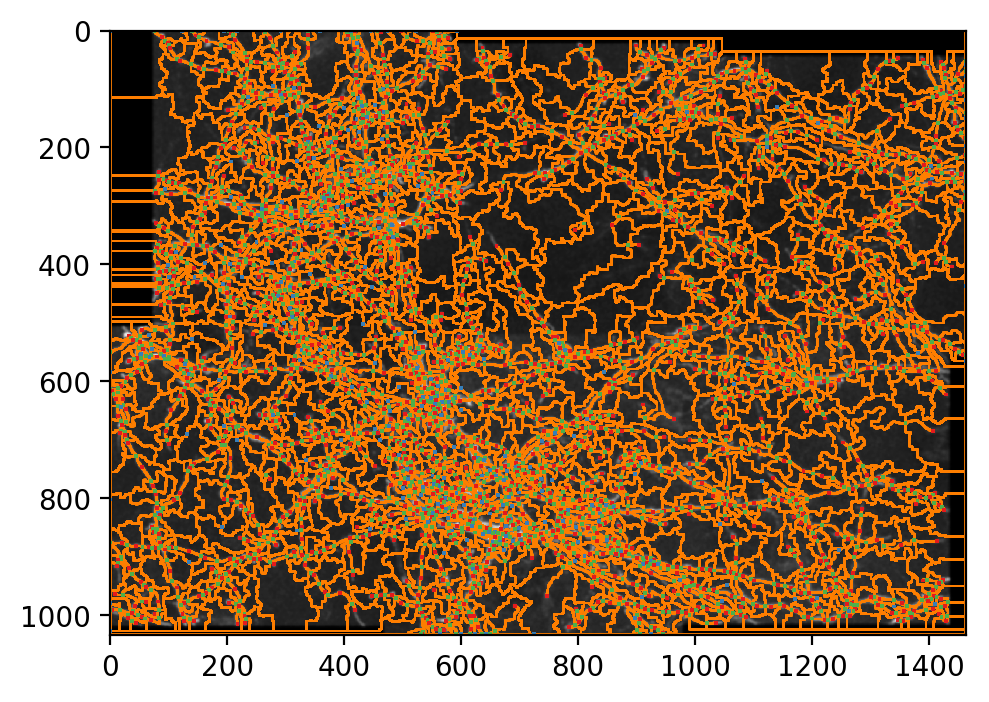

In [32]:
show_image(image)

for a in test_msc_coarse.arcs:
    points = np.array(a.line)
    plt.scatter(points[:, 0], points[:, 1], facecolor=orange, edgecolor='none', s=1, marker=',', alpha=0.5)

colors = [blue, green, red]
for node in test_msc_coarse.nodes.values():
    x, y = node.xy
    plt.scatter(x, y, facecolor=colors[node.index], edgecolor='none', marker=',', s=2)

plt.gca().set_xlim(0, image.shape[1])
_ = plt.gca().set_ylim(image.shape[0], 0)

# Selecting Training Data

## Fat Mask for Determining Feature vs. Non-Feature Selection

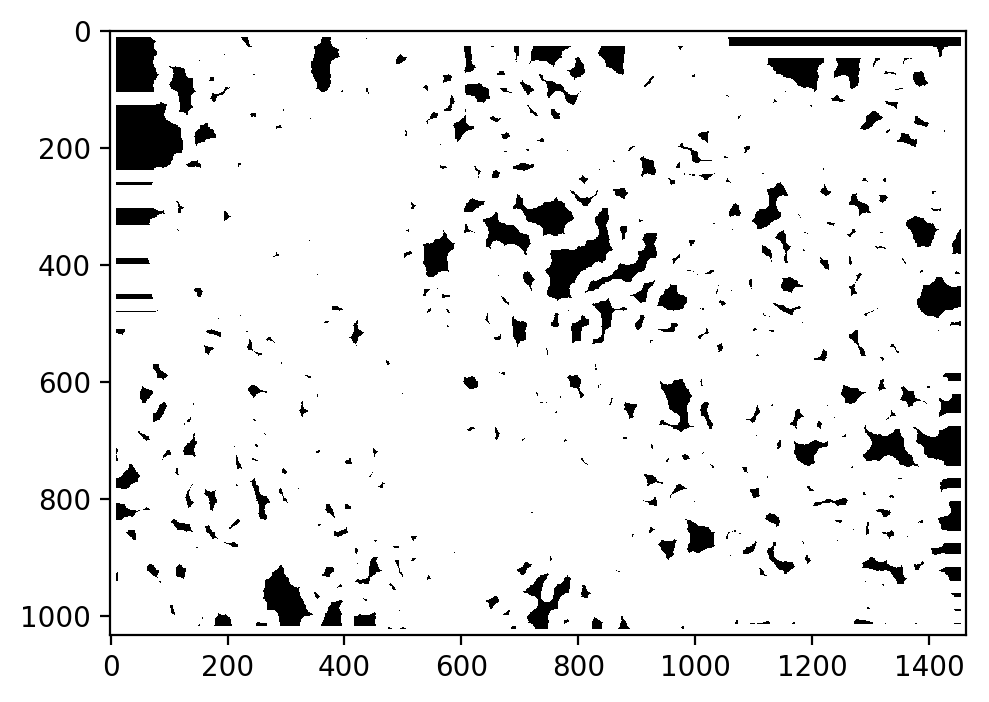

In [33]:
arc_mask_image = np.zeros(image.shape)
for a in test_msc_coarse.arcs:
    points = np.array(a.line)
    for point in points:
        arc_mask_image[int(point[1]), int(point[0])] = 1
        
fat_mask_image = morphology.dilation(arc_mask_image, selem=morphology.disk(10))
arc_mask_image = np.ma.masked_where(arc_mask_image == 0, arc_mask_image)
show_image(fat_mask_image)

## Data Structures and Helper Functions for Optimizing Some of this Code

My first lazy thought was to use axis-aligned bounding boxes to optimize this, but this still requires many tests and feels sluggish. I am leaving it here for provenance.

In [34]:
# BoundingBox = namedtuple('BoundingBox', ['mins', 'maxs'])
# bounding_boxes = []
# for a in test_msc_coarse.arcs:
#     polyline = np.array(a.line)
#     bb = BoundingBox(mins=np.min(polyline, axis=0), maxs=np.max(polyline, axis=0))
#     bounding_boxes.append(bb)
    
# def test_point_in_box(point, box):
#     for i, xi in enumerate(point):
#         if xi < box.mins[i] or xi > box.maxs[i]:
#             return False
#     return True

Instead, it works much better to take some extra upfront time to build a kd-tree and then use it to determine what arc index has been clicked on. There is still the matter of overlapping arcs. Ideally, the smaller arcs should be favored over the larger arcs, since the user can select the larger arc somewhere it does not overlap.

In [35]:
arc_map = []
arc_points = []

# This ensures smaller arcs take precedence in the event of pixel overlap
sorted_arcs = sorted(test_msc_coarse.arcs, key= lambda arc: len(arc.line))

for arc in sorted_arcs:
    index = tuple(arc.node_ids)
    arc_points.extend(arc.line)
    arc_map.extend([index]*len(arc.line))
    
kdtree = scipy.spatial.KDTree(arc_points, leafsize=1000)

def get_closest_arc_index(point):
    distance, index = kdtree.query(point)
    return arc_map[index]

## Interactive Selection

<IPython.core.display.Javascript object>


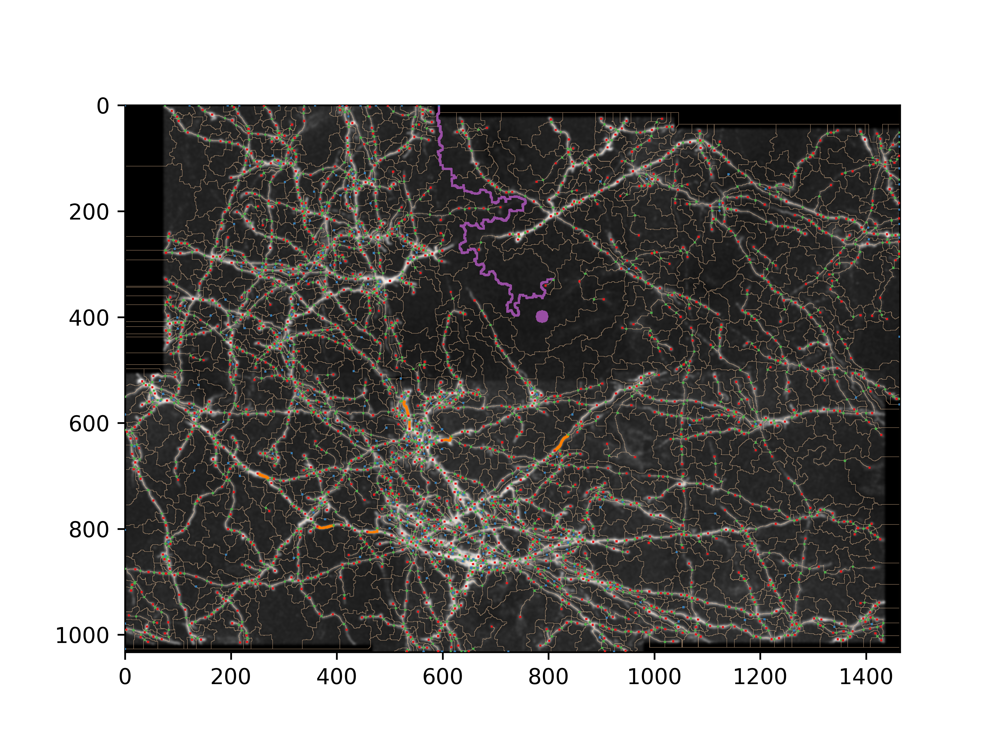

In [36]:
%matplotlib notebook

plt.ion()
fig = plt.figure(num=None, dpi=200)
plt.imshow(image, cmap=plt.cm.Greys_r, zorder=1)

selected_color = orange
background_color = purple

selected_arcs = {}
background_arcs = {}
arc_mask = np.zeros(image.shape)

for a in test_msc_coarse.arcs:
    arc_index = tuple(a.node_ids)
    points = np.array(a.line)
    for pt in points:
        arc_mask[int(pt[1]), int(pt[0])] = 1
    selected_arcs[arc_index] = plt.scatter(points[:, 0], points[:, 1], facecolor='none', edgecolor='none', s=1, marker=',', zorder=3)
    selected_arcs[arc_index].set_visible(False)
    
arc_mask = np.ma.masked_where(arc_mask == 0, arc_mask)
plt.imshow(arc_mask, cmap='Oranges', vmin=0, vmax=4, interpolation='none', alpha=0.5, zorder=2)


extrema_points = [[], [], []]
for node in test_msc_coarse.nodes.values():
    x, y = node.xy
    extrema_points[node.index].append([x, y])

for i, color in enumerate([blue, green, red]):
    xy = np.array(extrema_points[i])
    plt.scatter(xy[:, 0], xy[:, 1], facecolor=color, edgecolor='none', s=1, marker=',', zorder=4)
    
plt.gca().set_xlim(0, image.shape[1])
plt.gca().set_ylim(image.shape[0], 0)

selected_indices = set()
background_indices = set()
background_pixels = set()

radius = 10
shape = morphology.disk(radius)

def toggle_arc(x, y, in_class=True):
    min_distance = None
    min_index = None
    pt = np.array([x, y])
    min_index = get_closest_arc_index(pt)
#     for a, bb in zip(test_msc_coarse.arcs, bounding_boxes):
#         if test_point_in_box(pt, bb):
#             points = np.array(a.line)
#             distance = np.min(np.linalg.norm(np.array(a.line) - pt, axis=1))
#             if min_distance is None or distance < min_distance:
#                 min_distance = distance
#                 min_index = tuple(a.node_ids)
    if in_class:
        if min_index in selected_indices:
            selected_indices.remove(min_index)
        elif min_index in background_indices:
            background_indices.remove(min_index)
        else:
            selected_indices.add(min_index)
    else:
        if min_index in background_indices:
            background_indices.remove(min_index)
        elif min_index in selected_indices:
            selected_indices.remove(min_index)
        else:
            background_indices.add(min_index)            
    return min_index

def highlight_background(x, y):
    start_y = y - radius
    start_x = x - radius
    for i in range(0, 2*radius+1):
        xi = start_x + i
        if xi > 0 and xi < fat_mask_image.shape[1]:
            for j in range(0, 2*radius+1):
                yj = start_y + j
                if yj > 0 and yj < fat_mask_image.shape[0]:
                    if shape[j, i] and not fat_mask_image[yj, xi]:
                        background_pixels.add((xi, yj))

def onclick(event):
    if fat_mask_image[int(event.ydata), int(event.xdata)]:
        selected_index = toggle_arc(event.xdata, event.ydata, event.button == 1)
        selected_arcs[selected_index].set_visible(not selected_arcs[selected_index].get_visible())
        if event.button == 1:
            selected_arcs[selected_index].set_facecolor(selected_color)
        else:
            selected_arcs[selected_index].set_facecolor(background_color)
    else:
        highlight_background(int(event.xdata), int(event.ydata))
    
    bg_points = np.array(list(background_pixels))
    plt.scatter(bg_points[:, 0], bg_points[:, 1], edgecolor='none', facecolor=background_color, s=1, marker=',', zorder=4)
    fig.canvas.draw()

cid = fig.canvas.mpl_connect('button_press_event', onclick)

# Stash Generated Data for Later

In [ ]:
# Reset to static graphic rendering
%matplotlib inline

in_samples = tuple()
out_samples = tuple()
for arc in test_msc_coarse.arcs:
    index = tuple(arc.node_ids)
    if index in selected_indices:
        points = np.array(arc.line)
        in_samples += tuple(points, )
    elif index in background_indices:
        points = np.array(arc.line)
        out_samples += tuple(points, )

in_samples = np.vstack(in_samples)

out_samples += tuple(np.array(list(background_pixels)), )
out_samples = np.vstack(out_samples)

in_samples = np.array(in_samples, dtype=int)
out_samples = np.array(out_samples, dtype=int)
fname_base = fname_raw.rsplit('.', 1)[0]
np.savetxt(fname_base + '_in_samples.txt', in_samples, fmt='%d')
np.savetxt(fname_base + '_out_samples.txt', out_samples, fmt='%d')

In [ ]:
# First grab all of the single image variables
growing_tuple = (image,
                 sobel_image,
                 hessian_image,
                 bilateral_image,
                 gabor_real_image,
                 laplace_image,
                 largest_eig_image,
                 smallest_eig_image,
                 entropy_image)
dimensions = []
dimensions.append('original')
dimensions.append('sobel')
dimensions.append('hessian')
dimensions.append('bilateral')
dimensions.append('gabor')
dimensions.append('laplace')
dimensions.append('largest_eig_structure')
dimensions.append('smallest_eig_structure')
dimensions.append('entropy')
for i in range(len(diff_images)):
    dimensions.append('diff_{}'.format(i))
for i in range(len(mean_images)):
    dimensions.append('mean_{}'.format(i))
for i in range(len(variance_images)):
    dimensions.append('variance_{}'.format(i))
for i in range(len(median_images)):
    dimensions.append('median_{}'.format(i))
for i in range(len(minimum_images)):
    dimensions.append('min_{}'.format(i))
for i in range(len(minimum_images)):
    dimensions.append('max_{}'.format(i))
for i in range(len(neighbor_images)):
    dimensions.append('neighbor_{}'.format(i))
for i in range(len(membrane_projection_images)):
    dimensions.append('membrane_projection_{}'.format(i))
    

# Then add all of the multiple image variables
growing_tuple += tuple(diff_images)
growing_tuple += tuple(mean_images)
growing_tuple += tuple(variance_images)
growing_tuple += tuple(median_images)
growing_tuple += tuple(minimum_images)
growing_tuple += tuple(maximum_images)
growing_tuple += tuple(neighbor_images)
growing_tuple += tuple(membrane_projection_images)
# growing_tuple += tuple(arc_images.values())

compiled_data = np.dstack(growing_tuple)
print(compiled_data.shape)

fname_base = fname_raw.rsplit('.', 1)[0]
np.save(fname_base + '_input.npy', compiled_data)
fptr = open(fname_base + '_dimensions.txt', 'w')
for dimension in dimensions:
    fptr.write(dimension + "\n")
fptr.close()

# TODO: Arc-Specific Feature Generation

We discussed adding features specific to the pixels intersecting the arcs. Such as the maximum pixel value on an arc, minimum pixel value on an arc, etc.

In [ ]:
# arc_images = {}

# def mode(x):
#     return stats.mode(x)[0][0]

# aggregators = [np.min, np.max, np.mean, np.median, np.std, mode]

# for foo in aggregators:
#     arc_images[foo.__name__] = np.zeros(image.shape)

# for a in test_msc_coarse.arcs:
#     # swap x and y coordinates of the arcs to be row and column indices of the image matrix
#     indices = np.flip(np.array(a.line, dtype=int), axis=1)
#     values = [image[row, col] for row, col in indices]
#     for foo in aggregators:
#         value = foo(values)
#         for row, col in indices:
#             arc_images[foo.__name__][row, col] = value

# for title, arc_image in arc_images.items():
#     show_image(arc_image)
#     plt.gca().set_title(title)